In [2]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt  
xlsx_file = "Empower.csv"
init_data = pd.read_csv(xlsx_file)
init_data

,SETTLEMENTDATE,REGIONID,TOTALDEMAND
0,2017-01-01 00:30:00.000,NSW1,7259.07000
1,2017-01-01 00:30:00.000,QLD1,6462.14000
2,2017-01-01 00:30:00.000,SA1,1395.21000
3,2017-01-01 00:30:00.000,TAS1,863.08000
4,2017-01-01 00:30:00.000,VIC1,4097.58000
...,...,...,...
481675,2022-07-01 00:00:00.000,NSW1,8731.47500
481676,2022-07-01 00:00:00.000,QLD1,5624.54500
481677,2022-07-01 00:00:00.000,SA1,1694.35000
481678,2022-07-01 00:00:00.000,TAS1,1134.75833


In [3]:
xlsx_file = "ElecMMS3_ROOFTOP_PV_ACTUAL_pivot.csv"
PV_pivot_data = pd.read_csv(xlsx_file)
# PV_pivot_data = PV_pivot_data.fillna(0)
print(str(PV_pivot_data['POWER_DAILY']))
print(type(init_data['SETTLEMENTDATE']))

init_data['added_PV_TOTALDEMAND'] = init_data['TOTALDEMAND']
for i in range(len(init_data)):
    if not pd.isna(PV_pivot_data['POWER_DAILY'][i]): 
        init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_DAILY'][i] + init_data['TOTALDEMAND'][i]
    else:
        if pd.isna(PV_pivot_data['POWER_DAILY'][i]) and not pd.isna(PV_pivot_data['POWER_MEASUREMENT'][i]):
            init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_MEASUREMENT'][i] + init_data['TOTALDEMAND'][i]
PV_pivot_data


0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
481675    NaN
481676    NaN
481677    NaN
481678    NaN
481679    NaN
Name: POWER_DAILY, Length: 481680, dtype: float64
<class 'pandas.core.series.Series'>


<ipython-input-3-e79c58621987>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_DAILY'][i] + init_data['TOTALDEMAND'][i]
<ipython-input-3-e79c58621987>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_MEASUREMENT'][i] + init_data['TOTALDEMAND'][i]


,INTERVAL_DATETIME,REGIONID,POWER_DAILY,QI_DAILY,POWER_MEASUREMENT,QI_MEASUREMENT,POWER_SATELLITE,QI_SATELLITE
0,2017-01-01 00:30:00,NSW1,0.0,1.0,NaN,NaN,NaN,NaN
1,2017-01-01 00:30:00,QLD1,0.0,1.0,NaN,NaN,NaN,NaN
2,2017-01-01 00:30:00,SA1,0.0,1.0,NaN,NaN,NaN,NaN
3,2017-01-01 00:30:00,TAS1,0.0,1.0,NaN,NaN,NaN,NaN
4,2017-01-01 00:30:00,VIC1,0.0,1.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
481675,2022-07-01 00:00:00,NSW1,NaN,NaN,0.0,1.0,0.0,0.6
481676,2022-07-01 00:00:00,QLD1,NaN,NaN,0.0,1.0,0.0,0.6
481677,2022-07-01 00:00:00,SA1,NaN,NaN,0.0,1.0,0.0,0.6
481678,2022-07-01 00:00:00,TAS1,NaN,NaN,0.0,1.0,0.0,0.6


In [4]:
xlsx_file = "MarketData_dbo_Public_Holidays.csv"
Public_Holidays_data = pd.read_csv(xlsx_file)
Public_Holidays_data

,ID,Date,Holiday,NEM,AFMA_NSW,AFMA_VIC,AFMA_SA,AFMA_QLD,AFMA_TAS,ASX_NSW,...,ASX_SA,ASX_QLD,Official_NSW,Official_VIC,Official_QLD,Official_TAS,Official_SA,Official_ACT,Official_WA,Official_NT
0,1,2002-01-01,New Year's Day,True,True,True,True,True,True,False,...,False,False,True,True,True,True,True,True,True,True
1,2,2002-01-28,Australia Day,True,True,True,True,True,True,False,...,False,False,True,True,True,True,True,True,True,True
2,3,2002-02-11,Royal Hobart Regatta,False,False,False,False,False,True,False,...,False,False,False,False,False,True,False,False,False,False
3,4,2002-03-11,Eight Hours Day,False,False,False,False,False,True,False,...,False,False,False,False,False,True,False,False,False,False
4,5,2002-03-11,Labour Day,False,False,True,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,541,2033-08-10,Royal Queensland Show Day,NaN,False,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
561,542,2033-10-03,Labour Day,NaN,True,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
562,543,2033-11-01,Melbourne Cup Day,NaN,False,True,NaN,False,True,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
563,544,2033-12-26,Boxing Day,NaN,True,True,NaN,True,True,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN


In [6]:
init_data

,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND
0,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000
1,2017-01-01 00:30:00.000,QLD1,6462.14000,6462.14000
2,2017-01-01 00:30:00.000,SA1,1395.21000,1395.21000
3,2017-01-01 00:30:00.000,TAS1,863.08000,863.08000
4,2017-01-01 00:30:00.000,VIC1,4097.58000,4097.58000
...,...,...,...,...
481675,2022-07-01 00:00:00.000,NSW1,8731.47500,8731.47500
481676,2022-07-01 00:00:00.000,QLD1,5624.54500,5624.54500
481677,2022-07-01 00:00:00.000,SA1,1694.35000,1694.35000
481678,2022-07-01 00:00:00.000,TAS1,1134.75833,1134.75833


In [7]:
NSW_data = init_data[init_data.REGIONID == 'NSW1'].reset_index()
QLD_data = init_data[init_data.REGIONID == 'QLD1'].reset_index()
SA_data = init_data[init_data.REGIONID == 'SA1'].reset_index()
TAS_data = init_data[init_data.REGIONID == 'TAS1'].reset_index()
VIC_data = init_data[init_data.REGIONID == 'VIC1'].reset_index()
df = NSW_data
NSW_data

,index,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND
0,0,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000
1,5,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000
2,10,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000
3,15,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000
4,20,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000
...,...,...,...,...,...
96331,481655,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833
96332,481660,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833
96333,481665,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167
96334,481670,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667


In [8]:
NSW_data['date'] = pd.to_datetime(df['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")

In [9]:
# NSW_data['Timedate'] =NSW_data['date'].date()
# NSW_data

In [10]:
Public_Holidays_data['Timedate'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d")
Public_Holidays_data

,ID,Date,Holiday,NEM,AFMA_NSW,AFMA_VIC,AFMA_SA,AFMA_QLD,AFMA_TAS,ASX_NSW,...,ASX_QLD,Official_NSW,Official_VIC,Official_QLD,Official_TAS,Official_SA,Official_ACT,Official_WA,Official_NT,Timedate
0,1,2002-01-01,New Year's Day,True,True,True,True,True,True,False,...,False,True,True,True,True,True,True,True,True,2002-01-01
1,2,2002-01-28,Australia Day,True,True,True,True,True,True,False,...,False,True,True,True,True,True,True,True,True,2002-01-28
2,3,2002-02-11,Royal Hobart Regatta,False,False,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,2002-02-11
3,4,2002-03-11,Eight Hours Day,False,False,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,2002-03-11
4,5,2002-03-11,Labour Day,False,False,True,False,False,False,False,...,False,False,True,False,False,False,False,False,False,2002-03-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,541,2033-08-10,Royal Queensland Show Day,NaN,False,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-08-10
561,542,2033-10-03,Labour Day,NaN,True,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-10-03
562,543,2033-11-01,Melbourne Cup Day,NaN,False,True,NaN,False,True,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-11-01
563,544,2033-12-26,Boxing Day,NaN,True,True,NaN,True,True,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-12-26


In [11]:
NSW_data

,index,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date
0,0,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000,2017-01-01 00:30:00
1,5,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00
2,10,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00
3,15,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00
4,20,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00
...,...,...,...,...,...,...
96331,481655,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833,2022-06-30 22:00:00
96332,481660,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00
96333,481665,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00
96334,481670,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667,2022-06-30 23:30:00


In [12]:
%%time

Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data
df['is_public_holiday'] = 0
for j in range(len(df)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_NSW'][i] == True or Public_Holidays_data['AFMA_NSW'][i] == True or Public_Holidays_data['ASX_NSW'][i] == True:
            if Public_Holidays_data['Timedate'][i] == NSW_data['date'][j].date():
                print(NSW_data['date'][j].date())
                df['is_public_holiday'][j] = 1

#         
#             print(Public_Holidays_data['Date'][i])

2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


<timed exec>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14

2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26

2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-06-08
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05
2020-10-05

2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-15
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-18
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25
2022-04-25

In [13]:
df

,index,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday
0,0,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000,2017-01-01 00:30:00,0
1,5,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00,0
2,10,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00,0
3,15,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00,0
4,20,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00,0
...,...,...,...,...,...,...,...
96331,481655,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833,2022-06-30 22:00:00,0
96332,481660,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00,0
96333,481665,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00,0
96334,481670,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667,2022-06-30 23:30:00,0


In [14]:
data = pd.DataFrame(NSW_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]

In [15]:
data

,y
0,7259.07000
1,7046.41000
2,6845.24000
3,6629.92000
4,6472.71000
...,...
96331,9629.76833
96332,9513.61833
96333,9192.70167
96334,8971.18667


In [16]:
df.to_csv('NSW_df.csv')

In [17]:
# data.index = data.index.to_datetime()
data["hour"] = df.date.dt.hour
data["weekday"] = df.date.dt.weekday
data["month"] = df.date.dt.month
data["year"] = df.date.dt.year
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df.is_public_holiday
data


,y,hour,weekday,month,year,is_weekend,is_public_holiday
0,7259.07000,0,6,1,2017,1,0
1,7046.41000,1,6,1,2017,1,0
2,6845.24000,1,6,1,2017,1,0
3,6629.92000,2,6,1,2017,1,0
4,6472.71000,2,6,1,2017,1,0
...,...,...,...,...,...,...,...
96331,9629.76833,22,3,6,2022,0,0
96332,9513.61833,22,3,6,2022,0,0
96333,9192.70167,23,3,6,2022,0,0
96334,8971.18667,23,3,6,2022,0,0


67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
67439    7249.66000
            ...    
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
96335    8731.47500
Name: y, Length: 28901, dtype: float64
[9120.42746038 9120.42746038 9210.65545303 ... 9407.80793539 9407.80793539
 7270.8821213 ]
RMSE: 1117.812613


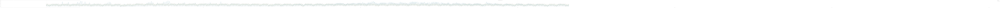

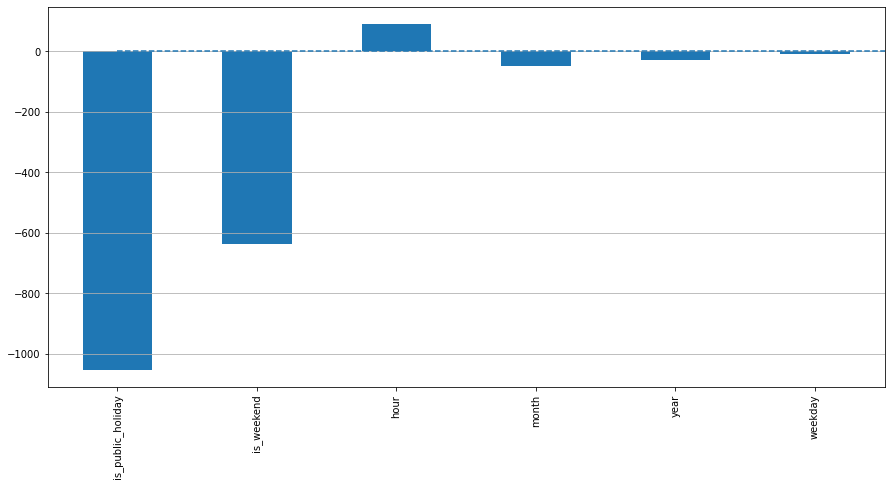

In [18]:
#GREEN: Prediction
#Bule:  Actual
from sklearn.model_selection import TimeSeriesSplit
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error

# for time-series cross-validation set 5 folds 
tscv = TimeSeriesSplit(n_splits=5)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()




def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def timeseries_train_test_split(X, y, test_size):
    """
        Perform train-test split with respect to time series structure
    """
    
    # get the index after which test set starts
    test_index = int(len(X)*(1-test_size))
    
    X_train = X.iloc[:test_index]
    y_train = y.iloc[:test_index]
    X_test = X.iloc[test_index:]
    y_test = y.iloc[test_index:]
    
    return X_train, X_test, y_train, y_test
y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)
X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)
def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=1.96):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
    plt.plot(y_test.values, label="actual", linewidth=2.0)
    
    if plot_intervals:
        cv = cross_val_score(model, X_train, y_train, 
                                    cv=tscv, 
                                    scoring="neg_mean_squared_error")
        #mae = cv.mean() * (-1)
        deviation = np.sqrt(cv.std())
        
        lower = prediction - (scale * deviation)
        upper = prediction + (scale * deviation)
        
        plt.plot(lower, "r--", label="upper bond / lower bond", alpha=0.5)
        plt.plot(upper, "r--", alpha=0.5)
        
        if plot_anomalies:
            anomalies = np.array([np.NaN]*len(y_test))
            anomalies[y_test<lower] = y_test[y_test<lower]
            anomalies[y_test>upper] = y_test[y_test>upper]
            plt.plot(anomalies, "o", markersize=10, label = "Anomalies")
    
    error = mean_absolute_percentage_error(prediction, y_test)
    print(y_test)
    print(prediction)
    plt.title("Mean absolute percentage error {0:.2f}%".format(error))
    rmse = np.sqrt(mean_squared_error(prediction, y_test))
    print("RMSE: %f" % (rmse))
    plt.legend(loc="best")
    plt.tight_layout()
    plt.grid(True);
    
def plotCoefficients(model):
    """
        Plots sorted coefficient values of the model
    """
    
    coefs = pd.DataFrame(model.coef_, X_train.columns)
    coefs.columns = ["coef"]
    coefs["abs"] = coefs.coef.apply(np.abs)
    coefs = coefs.sort_values(by="abs", ascending=False).drop(["abs"], axis=1)
    
    plt.figure(figsize=(15, 7))
    coefs.coef.plot(kind='bar')
    plt.grid(True, axis='y')
    plt.hlines(y=0, xmin=0, xmax=len(coefs), linestyles='dashed');
    
    
y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

# reserve 30% of data for testing


# machine learning in two lines
lr = LinearRegression()
lr.fit(X_train, y_train)

plotModelResults(lr, plot_intervals=True)
plotCoefficients(lr)

67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
67439    7249.66000
            ...    
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
96335    8731.47500
Name: y, Length: 28901, dtype: float64
[9120.42746038 9120.42746038 9210.65545303 ... 9407.80793539 9407.80793539
 7270.8821213 ]
RMSE: 1117.812613


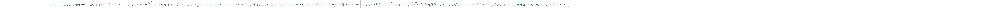

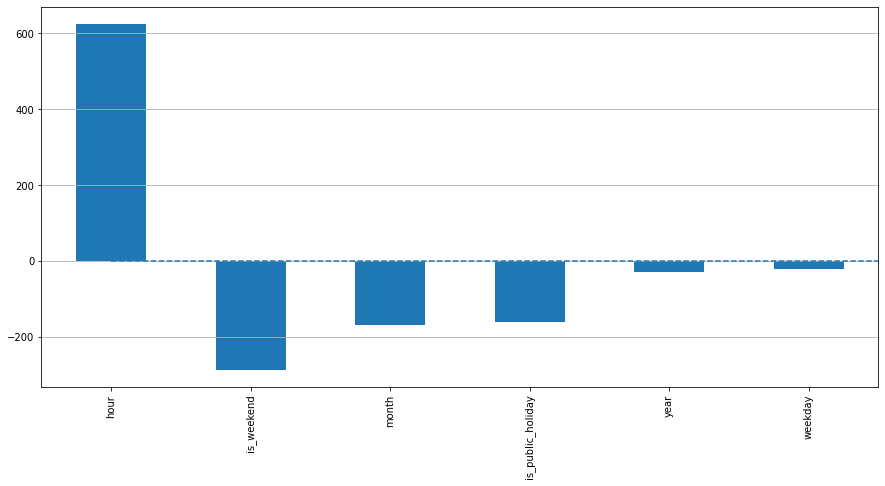

In [19]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

lr = LinearRegression()
lr.fit(X_train_scaled, y_train)

plotModelResults(lr, X_train=X_train_scaled, X_test=X_test_scaled, plot_intervals=True)
plotCoefficients(lr)

In [20]:
xlsx_file = "-33.86882_151.209295_Solcast_PT30M.csv"
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]

'2016-12-31T01:00:00Z'

In [21]:
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data

,PeriodEnd,PeriodStart,Period,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,RelativeHumidity,SnowWater,SurfacePressure,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,date
0,2016-12-31T01:30:00Z,2016-12-31T01:00:00Z,PT30M,26.4,-43,1.8,20.6,187,848,821,1009,40.4,70.5,0,990.6,144,4.2,14,0.08,2016-12-31 01:30:00
1,2016-12-31T02:00:00Z,2016-12-31T01:30:00Z,PT30M,26.4,-15,11.2,20.6,376,560,549,925,40.1,70.6,0,990.5,141,4.1,11,0.08,2016-12-31 02:00:00
2,2016-12-31T02:30:00Z,2016-12-31T02:00:00Z,PT30M,26.3,20,25.8,20.6,572,203,199,771,39.7,70.7,0,990.4,138,4.0,12,0.08,2016-12-31 02:30:00
3,2016-12-31T03:00:00Z,2016-12-31T02:30:00Z,PT30M,26.3,47,37.7,20.6,620,16,16,636,39.3,70.8,0,990.3,135,3.9,15,0.08,2016-12-31 03:00:00
4,2016-12-31T03:30:00Z,2016-12-31T03:00:00Z,PT30M,26.3,62,36.2,20.6,621,10,9,630,38.8,70.8,0,990.2,131,3.9,20,0.08,2016-12-31 03:30:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98584,2022-08-15T21:30:00Z,2022-08-15T21:00:00Z,PT30M,10.5,-67,0.0,5.6,28,449,57,86,15.8,71.5,0,1005.2,289,3.9,83,0.12,2022-08-15 21:30:00
98585,2022-08-15T22:00:00Z,2022-08-15T21:30:00Z,PT30M,11.2,-63,0.0,5.6,41,622,137,178,15.7,68.5,0,1005.3,288,3.9,77,0.12,2022-08-15 22:00:00
98586,2022-08-15T22:30:00Z,2022-08-15T22:00:00Z,PT30M,12.0,-58,0.0,5.5,48,722,225,273,15.5,64.6,0,1005.4,285,4.1,72,0.12,2022-08-15 22:30:00
98587,2022-08-15T23:00:00Z,2022-08-15T22:30:00Z,PT30M,12.9,-52,0.0,5.3,53,789,311,364,15.2,60.0,0,1005.4,281,4.4,67,0.12,2022-08-15 23:00:00


In [22]:
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data

,PeriodEnd,PeriodStart,Period,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,RelativeHumidity,SnowWater,SurfacePressure,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,date
0,2016-12-31T01:30:00Z,2016-12-31T01:00:00Z,PT30M,26.4,-43,1.8,20.6,187,848,821,1009,40.4,70.5,0,990.6,144,4.2,14,0.08,2016-12-31 11:30:00
1,2016-12-31T02:00:00Z,2016-12-31T01:30:00Z,PT30M,26.4,-15,11.2,20.6,376,560,549,925,40.1,70.6,0,990.5,141,4.1,11,0.08,2016-12-31 12:00:00
2,2016-12-31T02:30:00Z,2016-12-31T02:00:00Z,PT30M,26.3,20,25.8,20.6,572,203,199,771,39.7,70.7,0,990.4,138,4.0,12,0.08,2016-12-31 12:30:00
3,2016-12-31T03:00:00Z,2016-12-31T02:30:00Z,PT30M,26.3,47,37.7,20.6,620,16,16,636,39.3,70.8,0,990.3,135,3.9,15,0.08,2016-12-31 13:00:00
4,2016-12-31T03:30:00Z,2016-12-31T03:00:00Z,PT30M,26.3,62,36.2,20.6,621,10,9,630,38.8,70.8,0,990.2,131,3.9,20,0.08,2016-12-31 13:30:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98584,2022-08-15T21:30:00Z,2022-08-15T21:00:00Z,PT30M,10.5,-67,0.0,5.6,28,449,57,86,15.8,71.5,0,1005.2,289,3.9,83,0.12,2022-08-16 07:30:00
98585,2022-08-15T22:00:00Z,2022-08-15T21:30:00Z,PT30M,11.2,-63,0.0,5.6,41,622,137,178,15.7,68.5,0,1005.3,288,3.9,77,0.12,2022-08-16 08:00:00
98586,2022-08-15T22:30:00Z,2022-08-15T22:00:00Z,PT30M,12.0,-58,0.0,5.5,48,722,225,273,15.5,64.6,0,1005.4,285,4.1,72,0.12,2022-08-16 08:30:00
98587,2022-08-15T23:00:00Z,2022-08-15T22:30:00Z,PT30M,12.9,-52,0.0,5.3,53,789,311,364,15.2,60.0,0,1005.4,281,4.4,67,0.12,2022-08-16 09:00:00


In [23]:
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']

In [24]:
new_weather

,PeriodEnd,PeriodStart,Period,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,RelativeHumidity,SnowWater,SurfacePressure,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,date
27,2016-12-31T15:00:00Z,2016-12-31T14:30:00Z,PT30M,20.2,-167,0.0,19.2,0,0,0,0,38.0,94.3,0,992.5,131,2.6,122,0.09,2017-01-01 01:00:00
28,2016-12-31T15:30:00Z,2016-12-31T15:00:00Z,PT30M,20.0,-159,0.0,19.1,0,0,0,0,38.1,94.5,0,992.4,130,2.5,120,0.09,2017-01-01 01:30:00
29,2016-12-31T16:00:00Z,2016-12-31T15:30:00Z,PT30M,20.0,-152,0.0,19.1,0,0,0,0,38.1,94.5,0,992.4,128,2.3,118,0.09,2017-01-01 02:00:00
30,2016-12-31T16:30:00Z,2016-12-31T16:00:00Z,PT30M,20.0,-145,0.0,19.1,0,0,0,0,38.2,94.5,0,992.4,126,2.2,114,0.09,2017-01-01 02:30:00
31,2016-12-31T17:00:00Z,2016-12-31T16:30:00Z,PT30M,20.0,-139,0.0,19.1,0,0,0,0,38.3,94.5,0,992.3,123,2.0,110,0.09,2017-01-01 03:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96357,2022-06-30T12:00:00Z,2022-06-30T11:30:00Z,PT30M,14.8,101,73.2,8.9,0,0,0,0,21.7,67.5,0,1019.9,179,3.6,149,0.11,2022-06-30 22:00:00
96358,2022-06-30T12:30:00Z,2022-06-30T12:00:00Z,PT30M,14.6,109,72.2,9.1,0,0,0,0,22.0,69.6,0,1019.9,183,3.4,155,0.11,2022-06-30 22:30:00
96359,2022-06-30T13:00:00Z,2022-06-30T12:30:00Z,PT30M,14.4,119,68.6,9.3,0,0,0,0,22.1,71.5,0,1019.9,185,3.2,161,0.11,2022-06-30 23:00:00
96360,2022-06-30T13:30:00Z,2022-06-30T13:00:00Z,PT30M,14.2,136,60.0,9.5,0,0,0,0,22.2,73.5,0,1019.9,188,3.0,166,0.11,2022-06-30 23:30:00


In [25]:
new = pd.concat([new_weather,df],axis=0)

In [26]:
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()

In [27]:
df_col = pd.concat([new_merge,data], axis=1)

In [28]:
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,weekday,month,year,is_weekend,is_public_holiday
0,0.0,20.2,-167.0,0.0,19.2,0.0,0.0,0.0,0.0,38.0,...,2.6,122.0,0.09,7259.07000,0,6,1,2017,1,0
1,0.0,20.0,-159.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,2.5,120.0,0.09,7046.41000,1,6,1,2017,1,0
2,0.0,20.0,-152.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,2.3,118.0,0.09,6845.24000,1,6,1,2017,1,0
3,0.0,20.0,-145.0,0.0,19.1,0.0,0.0,0.0,0.0,38.2,...,2.2,114.0,0.09,6629.92000,2,6,1,2017,1,0
4,0.0,20.0,-139.0,0.0,19.1,0.0,0.0,0.0,0.0,38.3,...,2.0,110.0,0.09,6472.71000,2,6,1,2017,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,14.6,109.0,72.2,9.1,0.0,0.0,0.0,0.0,22.0,...,3.4,155.0,0.11,9629.76833,22,3,6,2022,0,0
96332,0.0,14.4,119.0,68.6,9.3,0.0,0.0,0.0,0.0,22.1,...,3.2,161.0,0.11,9513.61833,22,3,6,2022,0,0
96333,0.0,14.2,136.0,60.0,9.5,0.0,0.0,0.0,0.0,22.2,...,3.0,166.0,0.11,9192.70167,23,3,6,2022,0,0
96334,0.0,13.9,165.0,57.0,9.7,0.0,0.0,0.0,0.0,22.4,...,2.9,169.0,0.11,8971.18667,23,3,6,2022,0,0


67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64
[8564.34555842 8625.18600903 8612.52412019 ... 9401.71223422 9424.55721259
 9395.81086328]
RMSE: 911.228088


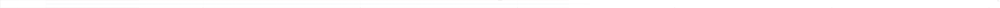

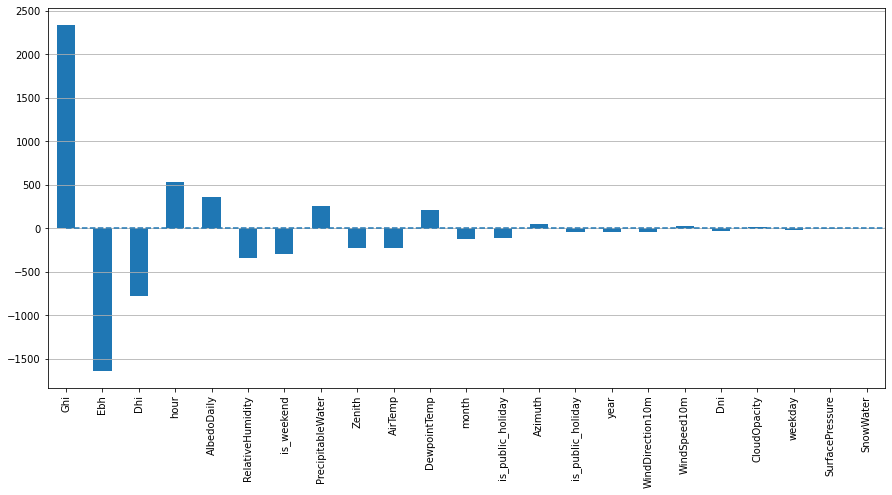

In [29]:
data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
# y_train_scaled = scaler.fit_transform(y_train)
# y_test_scaled = scaler.transform(y_test)

lr = LinearRegression()
lr.fit(X_train_scaled, y_train)

plotModelResults(lr, X_train=X_train_scaled, X_test=X_test_scaled, plot_intervals=True)
plotCoefficients(lr)

In [30]:
X_train

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,hour,weekday,month,year,is_weekend,is_public_holiday
0,0.0,20.2,-167.0,0.0,19.2,0.0,0.0,0.0,0.0,38.0,...,131.0,2.6,122.0,0.09,0,6,1,2017,1,0
1,0.0,20.0,-159.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,130.0,2.5,120.0,0.09,1,6,1,2017,1,0
2,0.0,20.0,-152.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,128.0,2.3,118.0,0.09,1,6,1,2017,1,0
3,0.0,20.0,-145.0,0.0,19.1,0.0,0.0,0.0,0.0,38.2,...,126.0,2.2,114.0,0.09,2,6,1,2017,1,0
4,0.0,20.0,-139.0,0.0,19.1,0.0,0.0,0.0,0.0,38.3,...,123.0,2.0,110.0,0.09,2,6,1,2017,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67429,0.0,13.9,117.0,80.6,11.1,0.0,0.0,0.0,0.0,25.3,...,217.0,8.3,100.0,0.09,19,3,11,2020,0,0
67430,0.0,13.9,122.0,69.0,11.7,0.0,0.0,0.0,0.0,26.1,...,209.0,9.1,106.0,0.09,19,3,11,2020,0,0
67431,0.0,14.3,127.0,78.6,12.0,0.0,0.0,0.0,0.0,26.1,...,197.0,9.9,111.0,0.09,20,3,11,2020,0,0
67432,0.0,15.0,133.0,77.3,12.0,0.0,0.0,0.0,0.0,25.4,...,184.0,10.8,116.0,0.09,20,3,11,2020,0,0


67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64
[8564.45052675 8625.24941749 8612.61576357 ... 9400.91022948 9423.94519468
 9395.54350806]
RMSE: 911.263785


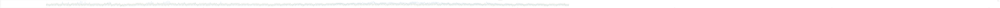

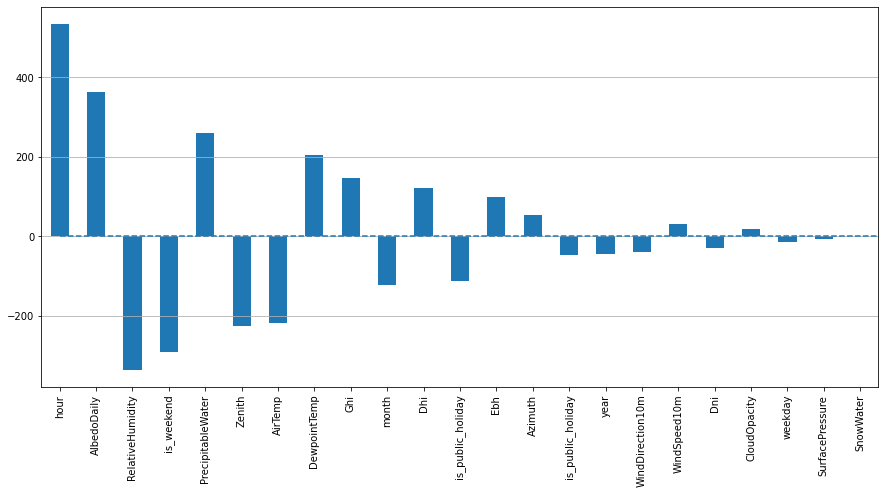

In [31]:
from sklearn.linear_model import LassoCV, RidgeCV

ridge = RidgeCV(cv=tscv)
ridge.fit(X_train_scaled, y_train)

plotModelResults(ridge, 
                 X_train=X_train_scaled, 
                 X_test=X_test_scaled, 
                 plot_intervals=True)
plotCoefficients(ridge)

67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64
[8537.76029198 8597.06810183 8588.47557336 ... 9164.35592063 9206.62235018
 9198.95043386]
RMSE: 929.111294


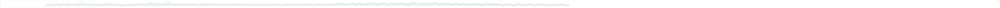

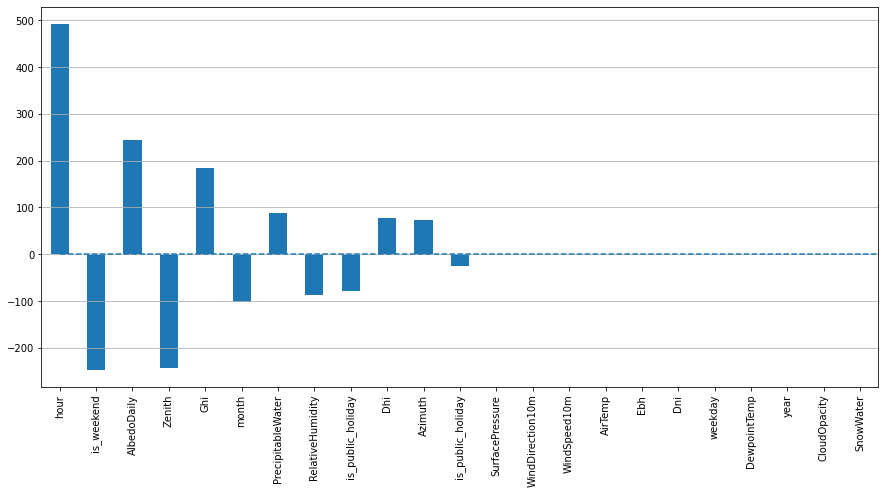

In [32]:
lasso = LassoCV(cv=tscv)
lasso.fit(X_train_scaled, y_train)

plotModelResults(lasso, 
                 X_train=X_train_scaled, 
                 X_test=X_test_scaled, 
                 plot_intervals=True)
plotCoefficients(lasso)

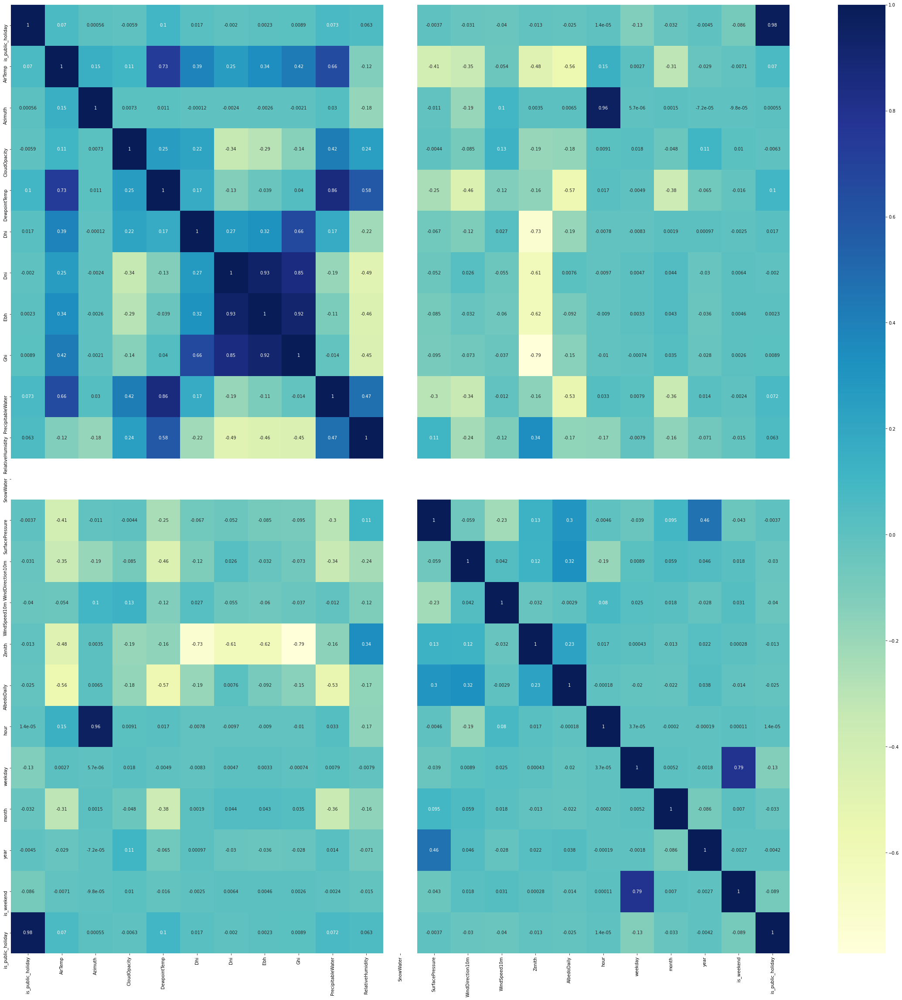

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

corr_df = X_train.corr()
plt.figure(figsize=(40, 40))
sns.heatmap(corr_df, cmap="YlGnBu", annot = True)

plt.show()

3.2756717255419336
RMSE: 369.173937


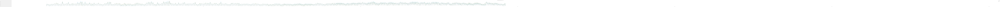

[153.05998 109.69459 116.65419 ... 175.44205 130.75044 139.24951]
Predictions(loc=array([7842.419, 7629.644, 7631.585, ..., 9117.93 , 8826.037, 8722.209],
      dtype=float32), scale=array([153.05998, 109.69459, 116.65419, ..., 175.44205, 130.75044,
       139.24951], dtype=float32))


In [121]:
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution(distribution="normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.loc, testpred.scale


plt.figure(figsize=(900, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+std, "r--",label="upper", alpha=0.5,linewidth=1.0)
plt.plot(mean-std,"r--", label="lower", alpha=0.5,linewidth=1.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)
# plotModelResults(xgb, 
#                  X_train=X_train_scaled, 
#                  X_test=X_test_scaled, 
#                  plot_intervals=False,plot_anomalies=False)


<function matplotlib.pyplot.show(close=None, block=None)>

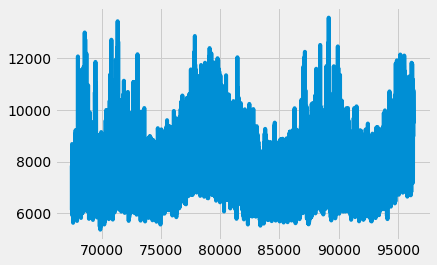

In [134]:
plt.plot(y_test)
plt.show

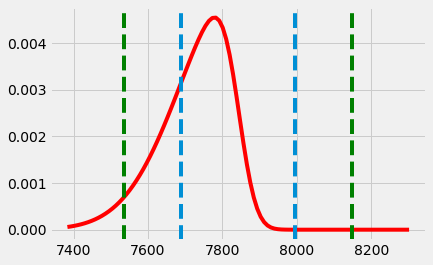

In [131]:
import matplotlib.pyplot as plt
import numpy as np 
import scipy.stats as stats 
import math

mu = testpred.loc[0]
# variance = 01
sigma = testpred.scale[0]


# x = np.linspace(mu - 1*sigma, mu + 1*sigma, 100)
# y = np.linspace(mu - 2*sigma, mu + 2*sigma, 100)
z = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
plt.plot(z, stats.skewnorm.pdf(z, -4,mu, sigma),color = 'red')
# plt.plot(z, stats.norm.pdf(z, mu, 2*sigma),color = 'blue')
# plt.plot(z, stats.norm.pdf(z, mu, 3*sigma),color = 'yellow')

plt.axvline(x=mu-sigma,linestyle = "--")
plt.axvline(x=mu+sigma,linestyle = "--")

plt.axvline(x=mu-2*sigma,linestyle = "--",color = 'green')
plt.axvline(x=mu+2*sigma,linestyle = "--",color = 'green')
# new_y = stats.norm.pdf(z,loc = mu,scale = sigma)
# plt.fill_between(x,new_y,color = 'red')
plt.show()

3.201719600429789
RMSE: 365.323124


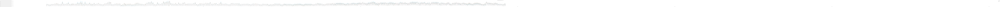

[0.01925334 0.014275   0.01497444 ... 0.01872073 0.01416912 0.00897836]
Predictions(scale=array([8085.4224, 7579.3643, 7573.317 , ..., 8851.327 , 8803.526 ,
       8643.903 ], dtype=float32), s=array([0.01925334, 0.014275  , 0.01497444, ..., 0.01872073, 0.01416912,
       0.00897836], dtype=float32))


In [185]:
# lognorm

from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(900, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)
# plotModelResults(xgb, 
#                  X_train=X_train_scaled, 
#                  X_test=X_test_scaled, 
#                  plot_intervals=False,plot_anomalies=False)


In [189]:
10**testpred.s

array([1.0453298, 1.0334156, 1.0350813, ..., 1.0440487, 1.0331637,
       1.0208886], dtype=float32)

In [184]:
#log norm try
import math
import numpy as np
from scipy.stats import lognorm

#make this example reproducible
np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
lognorm_values = lognorm.rvs(s=testpred.s[10], scale=testpred.scale[10], size=1000)

(array([1.38641317e-04, 5.68429399e-04, 1.67755993e-03, 3.46603292e-03,
        3.77104382e-03, 2.91146765e-03, 1.02594574e-03, 2.63418502e-04,
        1.38641317e-05, 2.77282634e-05]),
 array([5882.42793685, 5954.55650741, 6026.68507798, 6098.81364854,
        6170.9422191 , 6243.07078966, 6315.19936023, 6387.32793079,
        6459.45650135, 6531.58507192, 6603.71364248]),
 <BarContainer object of 10 artists>)

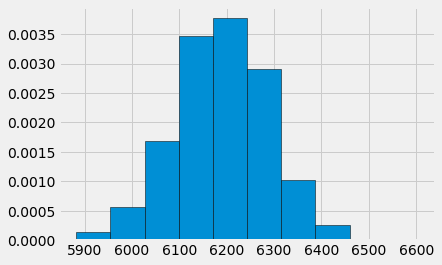

In [182]:
import matplotlib.pyplot as plt

#create histogram
plt.hist(lognorm_values, density=True, edgecolor='black')


<AxesSubplot:ylabel='Density'>

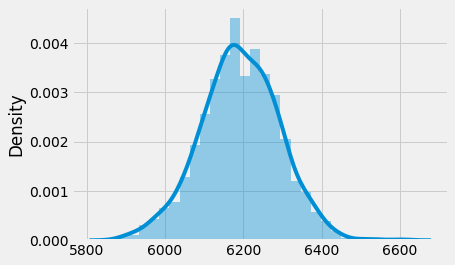

In [183]:
import seaborn as sns
import numpy as np
from scipy import stats

sns.distplot(lognorm_values)

In [209]:
len(y_test)//5

5780

In [213]:
len(y_test)//100

289

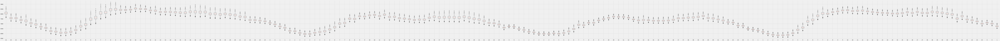

Wall time: 2.54 s


In [278]:
%%time
fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200):
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

In [271]:
y_test_reset[0:200]

array([7847.77 , 7635.76 , 7592.29 , 7459.78 , 7359.15 , 7249.66 ,
       7088.49 , 6889.91 , 6612.2  , 6380.07 , 6175.96 , 6128.52 ,
       6149.78 , 6225.58 , 6356.85 , 6656.312, 7111.927, 7592.409,
       8003.154, 8344.819, 8483.601, 8510.423, 8538.083, 8593.447,
       8682.926, 8605.195, 8477.393, 8421.111, 8317.767, 8281.145,
       8192.857, 8144.426, 8105.849, 8049.135, 7931.434, 7970.357,
       7952.802, 7942.53 , 7987.211, 7971.769, 7853.126, 7890.114,
       7820.076, 7900.102, 7917.11 , 7822.43 , 7677.7  , 7496.08 ,
       7438.63 , 7413.2  , 7375.52 , 7302.42 , 7179.13 , 7074.31 ,
       6906.52 , 6724.89 , 6511.91 , 6258.01 , 6053.67 , 5939.57 ,
       5906.9  , 5911.65 , 6000.26 , 6092.746, 6264.683, 6514.38 ,
       6858.431, 7176.51 , 7534.399, 7707.138, 7866.005, 7904.984,
       7963.603, 7789.139, 7783.937, 7757.458, 7790.768, 7757.556,
       7622.782, 7568.359, 7457.479, 7433.205, 7414.602, 7431.275,
       7433.444, 7448.682, 7420.861, 7474.497, 7541.158, 7586.

In [275]:
testpred.scale[0:200]

array([8085.4224, 7579.3643, 7573.317 , 7370.143 , 7283.0347, 7059.976 ,
       6927.2607, 6692.996 , 6574.599 , 6247.8345, 6186.309 , 6071.083 ,
       6091.8403, 6169.9946, 6348.887 , 6739.0986, 6905.692 , 7459.189 ,
       7616.028 , 8086.4326, 8157.2344, 8421.729 , 8467.214 , 8400.688 ,
       8403.364 , 8432.933 , 8555.698 , 8511.823 , 8489.829 , 8354.725 ,
       8326.082 , 8196.114 , 8211.794 , 8200.446 , 8171.6387, 8126.2617,
       8125.3394, 8211.065 , 8210.768 , 8176.987 , 8182.5566, 7999.757 ,
       8010.8955, 7939.1978, 8005.496 , 7926.821 , 7882.585 , 7731.198 ,
       7689.11  , 7378.3076, 7366.538 , 7316.4365, 7245.9497, 7084.8438,
       6941.552 , 6722.403 , 6587.93  , 6270.0093, 6233.028 , 6056.1113,
       5950.8364, 5954.163 , 6072.6465, 6158.1377, 6232.219 , 6416.2134,
       6642.7603, 7007.8213, 7074.3926, 7513.1196, 7489.298 , 7763.5522,
       7738.73  , 7855.0366, 7905.056 , 7781.1196, 7927.4785, 7693.291 ,
       7703.8267, 7572.898 , 7524.779 , 7452.946 , 

In [247]:
y_test_reset = y_test.values
y_test_reset

array([7847.77   , 7635.76   , 7592.29   , ..., 9513.61833, 9192.70167,
       8971.18667])

In [258]:
len(testpred.scale[0:200])

200

In [257]:
len(y_test_reset[0:200])

200

In [237]:
y_test[0:200].values

array([7847.77 , 7635.76 , 7592.29 , 7459.78 , 7359.15 , 7249.66 ,
       7088.49 , 6889.91 , 6612.2  , 6380.07 , 6175.96 , 6128.52 ,
       6149.78 , 6225.58 , 6356.85 , 6656.312, 7111.927, 7592.409,
       8003.154, 8344.819, 8483.601, 8510.423, 8538.083, 8593.447,
       8682.926, 8605.195, 8477.393, 8421.111, 8317.767, 8281.145,
       8192.857, 8144.426, 8105.849, 8049.135, 7931.434, 7970.357,
       7952.802, 7942.53 , 7987.211, 7971.769, 7853.126, 7890.114,
       7820.076, 7900.102, 7917.11 , 7822.43 , 7677.7  , 7496.08 ,
       7438.63 , 7413.2  , 7375.52 , 7302.42 , 7179.13 , 7074.31 ,
       6906.52 , 6724.89 , 6511.91 , 6258.01 , 6053.67 , 5939.57 ,
       5906.9  , 5911.65 , 6000.26 , 6092.746, 6264.683, 6514.38 ,
       6858.431, 7176.51 , 7534.399, 7707.138, 7866.005, 7904.984,
       7963.603, 7789.139, 7783.937, 7757.458, 7790.768, 7757.556,
       7622.782, 7568.359, 7457.479, 7433.205, 7414.602, 7431.275,
       7433.444, 7448.682, 7420.861, 7474.497, 7541.158, 7586.

In [226]:
X_test

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,hour,weekday,month,year,is_weekend,is_public_holiday
67434,0.0,15.5,147.0,77.0,11.8,0.0,0.0,0.0,0.0,24.8,...,189.0,10.1,124.0,0.09,21,3,11,2020,0,0
67435,0.0,15.6,155.0,80.0,11.7,0.0,0.0,0.0,0.0,24.4,...,191.0,9.9,127.0,0.09,22,3,11,2020,0,0
67436,0.0,15.6,163.0,75.4,11.6,0.0,0.0,0.0,0.0,23.8,...,189.0,10.2,129.0,0.09,22,3,11,2020,0,0
67437,0.0,15.6,173.0,48.0,11.5,0.0,0.0,0.0,0.0,22.9,...,187.0,10.3,130.0,0.09,23,3,11,2020,0,0
67438,0.0,15.7,-178.0,36.1,11.4,0.0,0.0,0.0,0.0,21.6,...,185.0,10.5,130.0,0.09,23,3,11,2020,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96330,0.0,14.8,101.0,73.2,8.9,0.0,0.0,0.0,0.0,21.7,...,179.0,3.6,149.0,0.11,21,3,6,2022,0,0
96331,0.0,14.6,109.0,72.2,9.1,0.0,0.0,0.0,0.0,22.0,...,183.0,3.4,155.0,0.11,22,3,6,2022,0,0
96332,0.0,14.4,119.0,68.6,9.3,0.0,0.0,0.0,0.0,22.1,...,185.0,3.2,161.0,0.11,22,3,6,2022,0,0
96333,0.0,14.2,136.0,60.0,9.5,0.0,0.0,0.0,0.0,22.2,...,188.0,3.0,166.0,0.11,23,3,6,2022,0,0


In [220]:
data

[array([8342.28201579, 7990.74805391, 8003.61778739, ..., 7929.08051393,
        8075.66824432, 7864.65709991]),
 array([7757.16438318, 7513.46318938, 7522.4333856 , ..., 7470.42897312,
        7572.5838483 , 7425.37905435]),
 array([7759.78635326, 7504.256725  , 7513.6551866 , ..., 7459.17557635,
        7566.2100901 , 7411.99647964]),
 array([7530.33460368, 7310.6994974 , 7318.79294463, ..., 7271.86167306,
        7364.02879313, 7231.18727789]),
 array([7532.67810148, 7191.17436545, 7203.65662991, ..., 7131.38515487,
        7273.56659368, 7068.9625763 ]),
 array([7247.9843033 , 6990.44003881, 6999.90024393, ..., 6945.07600648,
        7052.81793533, 6897.62449316]),
 array([7125.42254059, 6854.06655592, 6864.02132486, ..., 6806.34468356,
        6919.72358363, 6756.45123166]),
 array([6831.62383878, 6641.518822  , 6648.52877344, ..., 6607.87530513,
        6687.70211637, 6572.63187216]),
 array([6742.24924384, 6512.54549401, 6520.98925116, ..., 6472.04891388,
        6568.21241926, 

In [219]:
testpred.scale

array([8085.4224, 7579.3643, 7573.317 , ..., 8851.327 , 8803.526 ,
       8643.903 ], dtype=float32)

In [103]:
testpred.s

array([0.01925334, 0.014275  , 0.01497444, ..., 0.01872073, 0.01416912,
       0.00897836], dtype=float32)

In [77]:
len(testpred.loc)

28901

In [ ]:
np.random.stats.norm.pdf(z, mu, sigma)

67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64
[7712.913  7573.8965 7602.5293 ... 9110.84   8814.57   8666.581 ]


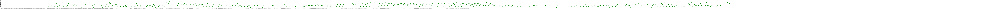

In [35]:
xgb2 = XGBRegressor()
xgb2.fit(X_train_scaled, y_train)
testpred = xgb2.predict(X_test_scaled)

plotModelResults(xgb2, 
                 X_train=X_train_scaled, 
                 X_test=X_test_scaled, 
                 plot_intervals=True) 

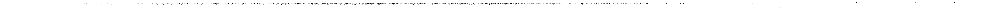

In [36]:

from matplotlib import pyplot as plt
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from scipy import stats

from xgboost_distribution import XGBDistribution


def plot_residuals(y_true, y_pred, y_err):
    fig, ax = plt.subplots(figsize=(900, 7))
    ax.errorbar(
        y_true,
        y_true - y_pred,
        yerr=y_err,
        marker="o",
        linestyle="None",
        c="k",
        markersize=2.5,
        linewidth=0.5,
    )
    ax.axhline(0, c="k", linestyle="--")
    ax.set_xlabel("y_test")
    ax.set_ylabel("y_test - y_pred")
    plt.show()


def main():
#     data = load_boston()
#     X, y = data.data, data.target
#     X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
    distribution_func = {"normal": getattr(stats, "norm").pdf,}
    model = XGBDistribution(
        distribution="normal",
        natural_gradient=True,
        max_depth=2,
        n_estimators=500,
    )
    model.fit(
        X_train_scaled,
        y_train,
        eval_set=[(X_test_scaled, y_test)]
#         early_stopping_rounds=10,
#         verbose=False,
    )
    preds = model.predict(X_test_scaled)
    
    dist = np.zeros(shape=(len(X_test_scaled),len(y_test)))
    
    for ii, x in enumerate(X_test_scaled):
        params = {field: param[ii] for (field, param) in zip(preds._fields, preds)}
        dist[ii] = distribution_func[model.distribution](y_test, **params)
        
        
    plot_residuals(y_true=y_test, y_pred=preds.loc, y_err=preds.scale)


if __name__ == "__main__":
    main()

In [37]:
X_test_scaled

array([[-0.15748548, -0.54938519,  1.48952345, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.57057403, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.65162461, ...,  1.41868494,
        -0.63199927, -0.15748548],
       ...,
       [-0.15748548, -0.78764588,  1.20584642, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.83096601,  1.37807891, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.89594619,  1.67188726, ...,  3.2388967 ,
        -0.63199927, -0.15748548]])

In [38]:
print(y_test)

67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64


In [39]:
print(testpred)

[7712.913  7573.8965 7602.5293 ... 9110.84   8814.57   8666.581 ]


In [40]:
rmse = np.sqrt(mean_squared_error(y_test, testpred))
print("RMSE: %f" % (rmse))

RMSE: 374.123666


<BarContainer object of 23 artists>

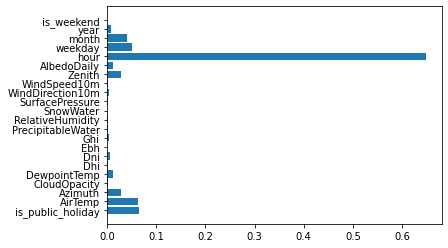

In [41]:
plt.barh(X_train.columns, xgb.feature_importances_)

In [42]:
X_test_scaled

array([[-0.15748548, -0.54938519,  1.48952345, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.57057403, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.65162461, ...,  1.41868494,
        -0.63199927, -0.15748548],
       ...,
       [-0.15748548, -0.78764588,  1.20584642, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.83096601,  1.37807891, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.89594619,  1.67188726, ...,  3.2388967 ,
        -0.63199927, -0.15748548]])

In [43]:
xgbboost.plot_tree()

NameError: name 'xgbboost' is not defined

In [44]:
y_test

67434    7847.77000
67435    7635.76000
67436    7592.29000
67437    7459.78000
67438    7359.15000
            ...    
96330    9948.01333
96331    9629.76833
96332    9513.61833
96333    9192.70167
96334    8971.18667
Name: y, Length: 28901, dtype: float64

In [45]:
y_train

0        7259.070
1        7046.410
2        6845.240
3        6629.920
4        6472.710
           ...   
67429    8798.434
67430    8692.850
67431    8515.760
67432    8252.220
67433    7988.460
Name: y, Length: 67434, dtype: float64

In [46]:
X_test_scaled

array([[-0.15748548, -0.54938519,  1.48952345, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.57057403, ...,  1.41868494,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.52772513,  1.65162461, ...,  1.41868494,
        -0.63199927, -0.15748548],
       ...,
       [-0.15748548, -0.78764588,  1.20584642, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.83096601,  1.37807891, ...,  3.2388967 ,
        -0.63199927, -0.15748548],
       [-0.15748548, -0.89594619,  1.67188726, ...,  3.2388967 ,
        -0.63199927, -0.15748548]])

In [47]:
X_test

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindDirection10m,WindSpeed10m,Zenith,AlbedoDaily,hour,weekday,month,year,is_weekend,is_public_holiday
67434,0.0,15.5,147.0,77.0,11.8,0.0,0.0,0.0,0.0,24.8,...,189.0,10.1,124.0,0.09,21,3,11,2020,0,0
67435,0.0,15.6,155.0,80.0,11.7,0.0,0.0,0.0,0.0,24.4,...,191.0,9.9,127.0,0.09,22,3,11,2020,0,0
67436,0.0,15.6,163.0,75.4,11.6,0.0,0.0,0.0,0.0,23.8,...,189.0,10.2,129.0,0.09,22,3,11,2020,0,0
67437,0.0,15.6,173.0,48.0,11.5,0.0,0.0,0.0,0.0,22.9,...,187.0,10.3,130.0,0.09,23,3,11,2020,0,0
67438,0.0,15.7,-178.0,36.1,11.4,0.0,0.0,0.0,0.0,21.6,...,185.0,10.5,130.0,0.09,23,3,11,2020,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96330,0.0,14.8,101.0,73.2,8.9,0.0,0.0,0.0,0.0,21.7,...,179.0,3.6,149.0,0.11,21,3,6,2022,0,0
96331,0.0,14.6,109.0,72.2,9.1,0.0,0.0,0.0,0.0,22.0,...,183.0,3.4,155.0,0.11,22,3,6,2022,0,0
96332,0.0,14.4,119.0,68.6,9.3,0.0,0.0,0.0,0.0,22.1,...,185.0,3.2,161.0,0.11,22,3,6,2022,0,0
96333,0.0,14.2,136.0,60.0,9.5,0.0,0.0,0.0,0.0,22.2,...,188.0,3.0,166.0,0.11,23,3,6,2022,0,0


In [48]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
# parameters={'n_estimators':range(10, 300, 10),
#             'max_depth':range(2,10,1),
#             'learning_rate': [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3],
#             }
# #parameters={'max_depth':range(2,10,1)}
# model=XGBRegressor(
#                      n_estimators=100,
#                      max_depth=3,
#                      eval_metric='rmse',
#                      learning_rate=0.1,
#                      min_child_weight=1,
#                      subsample=1,
#                      colsample_bytree=1,
#                      colsample_bylevel=1,
#                      gamma=0)
# gs=RandomizedSearchCV(estimator= model,param_grid=parameters,cv=5,refit= True,scoring='neg_mean_squared_error')

# gs.fit(X_train_scaled,y_train)
# print('最优参数: ', gs.best_params_)

# est_scaled = gs.predict(X_train_scaled)
# train['est'] = est_scaled * math.sqrt(scaler.var_[0]) + scaler.mean_[0]

# pre_y_scaled = gs.predict(X_sample_scaled)
# test['pre_y_scaled'] = pre_y_scaled
# test['pre_y']=test['pre_y_scaled'] * test['adj_close_std'] + test['adj_close_mean']

In [ ]:
%%time
cv_params = {'n_estimators': [400, 500, 600, 700, 800],
            'max_depth':[2,4,6,8,10],
            'learning_rate': [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3]}
other_params = {'learning_rate': 0.1, 'n_estimators': 500, 'max_depth': 5, 'min_child_weight': 1, 'seed': 0,
                'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}

model = XGBRegressor(**other_params)
optimized_GBM = GridSearchCV(estimator=model, param_grid=cv_params, scoring='r2', cv=5, verbose=1, n_jobs=4)
optimized_GBM.fit(X_train_scaled, y_train)
evalute_result = optimized_GBM.cv_results_
print('每轮迭代运行结果:{0}'.format(evalute_result))
print('参数的最佳取值：{0}'.format(optimized_GBM.best_params_))
print('最佳模型得分:{0}'.format(optimized_GBM.best_score_))

In [ ]:
# cv_params = {'max_depth': [3, 4, 5, 6, 7, 8, 9, 10], 'min_child_weight': [1, 2, 3, 4, 5, 6]}
# other_params = {'learning_rate': 0.1, 'n_estimators': 800, 'max_depth': 5, 'min_child_weight': 1, 'seed': 0,
#                     'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}
# model = XGBRegressor(**other_params)
# optimized_GBM = GridSearchCV(estimator=model, param_grid=cv_params, scoring='r2', cv=5, verbose=1, n_jobs=4)
# optimized_GBM.fit(X_train_scaled, y_train)
# evalute_result = optimized_GBM.cv_results_
# print('每轮迭代运行结果:{0}'.format(evalute_result))
# print('参数的最佳取值：{0}'.format(optimized_GBM.best_params_))
# print('最佳模型得分:{0}'.format(optimized_GBM.best_score_))

In [49]:
import numpy as np
import pandas as pd

# Plots
# ==============================================================================
import matplotlib.pyplot as plt
import seaborn as sns

from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
plt.style.use('fivethirtyeight')

# Warnings configuration
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

# Modeling and Forecasting
# ==============================================================================
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error

# from skforecast.ForecasterAutoreg import ForecasterAutoreg
# from skforecast.ForecasterAutoregMultiOutput import ForecasterAutoregMultiOutput
# from skforecast.model_selection import grid_search_forecaster
# from skforecast.model_selection import backtesting_forecaster
# from skforecast.model_selection import backtesting_forecaster_intervals

In [50]:
df = df.drop(columns = ['index'])

In [51]:
df_1 = df


In [52]:
df['Time']= df['date']
df = df.set_index('Time')
df = df.asfreq('30min')
df = df.sort_index()
df = df.reset_index()
df

,Time,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday
0,2017-01-01 00:30:00,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000,2017-01-01 00:30:00,0
1,2017-01-01 01:00:00,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00,0
2,2017-01-01 01:30:00,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00,0
3,2017-01-01 02:00:00,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00,0
4,2017-01-01 02:30:00,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00,0
...,...,...,...,...,...,...,...
96331,2022-06-30 22:00:00,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833,2022-06-30 22:00:00,0
96332,2022-06-30 22:30:00,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00,0
96333,2022-06-30 23:00:00,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00,0
96334,2022-06-30 23:30:00,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667,2022-06-30 23:30:00,0


In [53]:
print(f"Number of rows with missing values: {data.isnull().any(axis=1).mean()}")

Number of rows with missing values: 1.0380335492443116e-05


In [54]:
df.index = df['Time']

In [55]:
df

,Time,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday
Time,,,,,,,
2017-01-01 00:30:00,2017-01-01 00:30:00,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000,2017-01-01 00:30:00,0
2017-01-01 01:00:00,2017-01-01 01:00:00,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00,0
2017-01-01 01:30:00,2017-01-01 01:30:00,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00,0
2017-01-01 02:00:00,2017-01-01 02:00:00,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00,0
2017-01-01 02:30:00,2017-01-01 02:30:00,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00,0
...,...,...,...,...,...,...,...
2022-06-30 22:00:00,2022-06-30 22:00:00,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833,2022-06-30 22:00:00,0
2022-06-30 22:30:00,2022-06-30 22:30:00,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00,0
2022-06-30 23:00:00,2022-06-30 23:00:00,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00,0


In [56]:
# Split data into train-val-test
# ==============================================================================
df = df.loc['2017-01-01 00:30:00': '2022-07-01 00:00:00']
end_train = '2021-01-01 00:00:00'
end_validation = '2022-01-01 00:00:00'
data_train = df.loc[: end_train, :]
data_val   = df.loc[end_train:end_validation, :]
data_test  = df.loc[end_validation:, :]

print(f"Train dates      : {data_train.index.min()} --- {data_train.index.max()}")
print(f"Validation dates : {data_val.index.min()} --- {data_val.index.max()}")
print(f"Test dates       : {data_test.index.min()} --- {data_test.index.max()}")

Train dates      : 2017-01-01 00:30:00 --- 2021-01-01 00:00:00
Validation dates : 2021-01-01 00:00:00 --- 2022-01-01 00:00:00
Test dates       : 2022-01-01 00:00:00 --- 2022-07-01 00:00:00


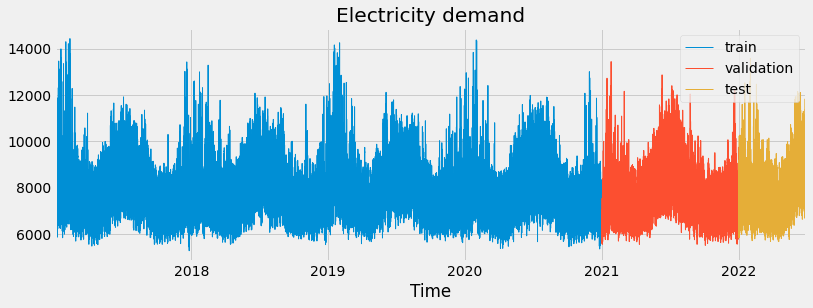

In [57]:
# Time series plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(12, 4))
data_train.added_PV_TOTALDEMAND.plot(ax=ax, label='train', linewidth=1)
data_val.added_PV_TOTALDEMAND.plot(ax=ax, label='validation', linewidth=1)
data_test.added_PV_TOTALDEMAND.plot(ax=ax, label='test', linewidth=1)
ax.set_title('Electricity demand')
ax.legend();

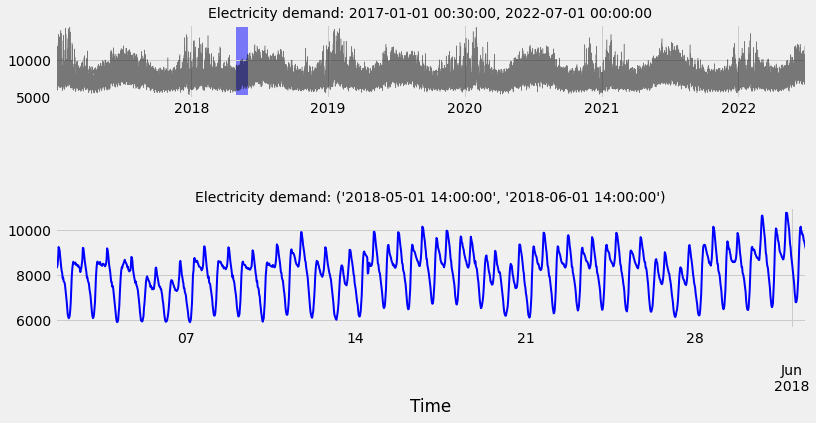

In [58]:
data = df
data.Demand = df.added_PV_TOTALDEMAND

# Zooming time series chart
# ==============================================================================
zoom = ('2018-05-01 14:00:00','2018-06-01 14:00:00')

fig = plt.figure(figsize=(12, 6))
grid = plt.GridSpec(nrows=8, ncols=1, hspace=0.6, wspace=0)

main_ax = fig.add_subplot(grid[1:3, :])
zoom_ax = fig.add_subplot(grid[5:, :])

data.added_PV_TOTALDEMAND.plot(ax=main_ax, c='black', alpha=0.5, linewidth=0.5)
min_y = min(data.added_PV_TOTALDEMAND)
max_y = max(data.added_PV_TOTALDEMAND)
main_ax.fill_between(zoom, min_y, max_y, facecolor='blue', alpha=0.5, zorder=0)
main_ax.set_xlabel('')

data.loc[zoom[0]: zoom[1]].added_PV_TOTALDEMAND.plot(ax=zoom_ax, color='blue', linewidth=2)

main_ax.set_title(f'Electricity demand: {data.index.min()}, {data.index.max()}', fontsize=14)
zoom_ax.set_title(f'Electricity demand: {zoom}', fontsize=14)
plt.subplots_adjust(hspace=1)

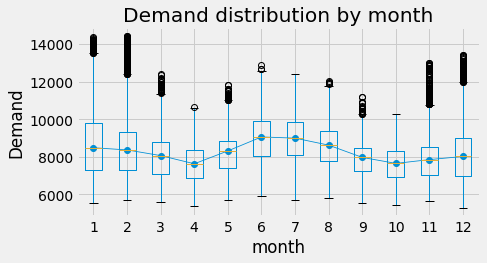

In [59]:
# Boxplot for annual seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['month'] = data.index.month
data.boxplot(column='added_PV_TOTALDEMAND', by='month', ax=ax,)
data.groupby('month')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by month')
fig.suptitle('');

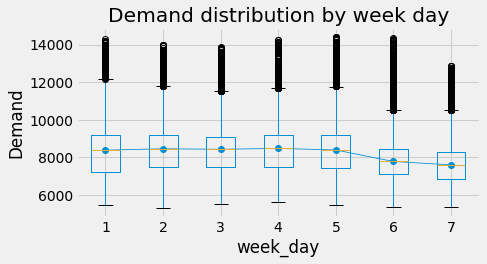

In [60]:
# Boxplot for weekly seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['week_day'] = data.index.day_of_week + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='week_day', ax=ax)
data.groupby('week_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by week day')
fig.suptitle('');

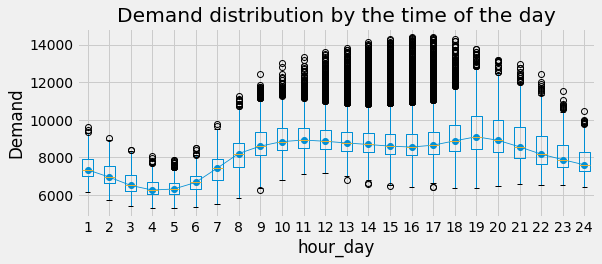

In [61]:
# Boxplot for daily seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 3.5))
data['hour_day'] = data.index.hour + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='hour_day', ax=ax)
data.groupby('hour_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by the time of the day')
fig.suptitle('');

In [62]:
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.ForecasterAutoregMultiOutput import ForecasterAutoregMultiOutput
from skforecast.model_selection import grid_search_forecaster
from skforecast.model_selection import backtesting_forecaster
# from skforecast.model_selection import backtesting_forecaster_intervals

In [63]:
import skforecast

In [64]:
data

,Time,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday,month,week_day,hour_day
Time,,,,,,,,,,
2017-01-01 00:30:00,2017-01-01 00:30:00,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000,2017-01-01 00:30:00,0,1,7,1
2017-01-01 01:00:00,2017-01-01 01:00:00,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00,0,1,7,2
2017-01-01 01:30:00,2017-01-01 01:30:00,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00,0,1,7,2
2017-01-01 02:00:00,2017-01-01 02:00:00,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00,0,1,7,3
2017-01-01 02:30:00,2017-01-01 02:30:00,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00,0,1,7,3
...,...,...,...,...,...,...,...,...,...,...
2022-06-30 22:00:00,2022-06-30 22:00:00,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833,2022-06-30 22:00:00,0,6,4,23
2022-06-30 22:30:00,2022-06-30 22:30:00,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00,0,6,4,23
2022-06-30 23:00:00,2022-06-30 23:00:00,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00,0,6,4,24


In [65]:
import joblib
import pandas as pd
from sklearn.metrics import accuracy_score
joblib.dump(xgb, "xgb.joblib.dat")

PicklingError: Can't pickle <class 'xgboost_distribution.distributions.base.Predictions'>: it's not the same object as xgboost_distribution.distributions.base.Predictions

In [66]:
loaded_model = joblib.load("xgb.joblib.dat")


y_pred = loaded_model.predict(X_test_scaled) # X_test 特征集
predictions = [round(value) for value in y_pred]

print(predictions)

EOFError: 

In [68]:
df_VIC=VIC_data
VIC_data['date'] = pd.to_datetime(df_VIC['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_VIC['is_public_holiday'] = 0
for j in range(len(df_VIC)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_VIC'][i] == True or Public_Holidays_data['AFMA_VIC'][i] == True or Public_Holidays_data['ASX_VIC'][i] == True:
            if Public_Holidays_data['Timedate'][i] == VIC_data['date'][j].date():
                print(VIC_data['date'][j].date())
                df_VIC['is_public_holiday'][j] = 1
                                  


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26

2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11

2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01

2021-03-08
2021-03-08
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05

In [69]:
# data["hour"] = df.date.dt.hour
# data["weekday"] = df.date.dt.weekday
# data["month"] = df.date.dt.month
# data["year"] = df.date.dt.year
# data['is_weekend'] = data.weekday.isin([5,6])*1
# data["is_public_holiday"] = df.is_public_holiday
# data





data = pd.DataFrame(VIC_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_VIC.date.dt.hour
data["month"] = df_VIC.date.dt.month
data["year"] = df_VIC.date.dt.year
data["weekday"] = df_VIC.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_VIC.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,4097.58000,0,1,2017,6,1,0
1,4034.74000,1,1,2017,6,1,0
2,3851.70000,1,1,2017,6,1,0
3,3649.99000,2,1,2017,6,1,0
4,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,6251.47333,22,6,2022,3,0,0
96332,5930.04667,22,6,2022,3,0,0
96333,5685.67833,23,6,2022,3,0,0
96334,5698.64333,23,6,2022,3,0,0


In [73]:
xlsx_file = "-37.813628_144.963058_Solcast_PT30M.csv"   #VIC
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']

new_weather
print(len(new_weather))
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date']) 
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'}) 
new_merge = new_merge.reset_index() 
df_col = pd.concat([new_merge,data], axis=1)
df_col
train_data = df_col.drop(columns=['index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data


96335


,Time,is_public_holiday,month,week_day,hour_day,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,2017-01-01 01:00:00,0.0,1.0,7.0,2.0,15.3,-174.0,0.0,13.6,0.0,...,2.5,119.0,0.13,4097.58000,0,1,2017,6,1,0
1,2017-01-01 01:30:00,0.0,1.0,7.0,2.0,15.2,-166.0,0.0,13.6,0.0,...,2.5,118.0,0.13,4034.74000,1,1,2017,6,1,0
2,2017-01-01 02:00:00,0.0,1.0,7.0,3.0,15.1,-159.0,0.0,13.6,0.0,...,2.5,116.0,0.13,3851.70000,1,1,2017,6,1,0
3,2017-01-01 02:30:00,0.0,1.0,7.0,3.0,15.0,-152.0,0.0,13.6,0.0,...,2.5,114.0,0.13,3649.99000,2,1,2017,6,1,0
4,2017-01-01 03:00:00,0.0,1.0,7.0,4.0,14.9,-145.0,0.0,13.6,0.0,...,2.5,110.0,0.13,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,2022-06-30 22:30:00,0.0,6.0,4.0,23.0,7.9,109.0,40.5,4.8,0.0,...,0.3,149.0,0.15,6251.47333,22,6,2022,3,0,0
96332,2022-06-30 23:00:00,0.0,6.0,4.0,24.0,7.9,118.0,62.9,5.0,0.0,...,0.6,155.0,0.15,5930.04667,22,6,2022,3,0,0
96333,2022-06-30 23:30:00,0.0,6.0,4.0,24.0,8.0,130.0,73.9,5.3,0.0,...,0.7,159.0,0.15,5685.67833,23,6,2022,3,0,0
96334,2022-07-01 00:00:00,0.0,7.0,5.0,1.0,8.2,149.0,68.7,5.6,0.0,...,0.6,163.0,0.15,5698.64333,23,6,2022,3,0,0


In [72]:
df_col

,index,Time,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday,month,week_day,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,2017-01-01 01:00:00,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000,2017-01-01 01:00:00,0.0,1.0,7.0,...,2.5,119.0,0.13,4097.58000,0,1,2017,6,1,0
1,1.0,2017-01-01 01:30:00,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000,2017-01-01 01:30:00,0.0,1.0,7.0,...,2.5,118.0,0.13,4034.74000,1,1,2017,6,1,0
2,2.0,2017-01-01 02:00:00,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000,2017-01-01 02:00:00,0.0,1.0,7.0,...,2.5,116.0,0.13,3851.70000,1,1,2017,6,1,0
3,3.0,2017-01-01 02:30:00,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000,2017-01-01 02:30:00,0.0,1.0,7.0,...,2.5,114.0,0.13,3649.99000,2,1,2017,6,1,0
4,4.0,2017-01-01 03:00:00,2017-01-01 03:00:00.000,NSW1,6373.64000,6373.64000,2017-01-01 03:00:00,0.0,1.0,7.0,...,2.5,110.0,0.13,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,96331.0,2022-06-30 22:30:00,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833,2022-06-30 22:30:00,0.0,6.0,4.0,...,0.3,149.0,0.15,6251.47333,22,6,2022,3,0,0
96332,96332.0,2022-06-30 23:00:00,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167,2022-06-30 23:00:00,0.0,6.0,4.0,...,0.6,155.0,0.15,5930.04667,22,6,2022,3,0,0
96333,96333.0,2022-06-30 23:30:00,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667,2022-06-30 23:30:00,0.0,6.0,4.0,...,0.7,159.0,0.15,5685.67833,23,6,2022,3,0,0
96334,96334.0,2022-07-01 00:00:00,2022-07-01 00:00:00.000,NSW1,8731.47500,8731.47500,2022-07-01 00:00:00,0.0,7.0,5.0,...,0.6,163.0,0.15,5698.64333,23,6,2022,3,0,0


In [77]:
data = train_data
data=data.drop(columns=['Time'])
data

,is_public_holiday,month,week_day,hour_day,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,1.0,7.0,2.0,15.3,-174.0,0.0,13.6,0.0,0.0,...,2.5,119.0,0.13,4097.58000,0,1,2017,6,1,0
1,0.0,1.0,7.0,2.0,15.2,-166.0,0.0,13.6,0.0,0.0,...,2.5,118.0,0.13,4034.74000,1,1,2017,6,1,0
2,0.0,1.0,7.0,3.0,15.1,-159.0,0.0,13.6,0.0,0.0,...,2.5,116.0,0.13,3851.70000,1,1,2017,6,1,0
3,0.0,1.0,7.0,3.0,15.0,-152.0,0.0,13.6,0.0,0.0,...,2.5,114.0,0.13,3649.99000,2,1,2017,6,1,0
4,0.0,1.0,7.0,4.0,14.9,-145.0,0.0,13.6,0.0,0.0,...,2.5,110.0,0.13,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,6.0,4.0,23.0,7.9,109.0,40.5,4.8,0.0,0.0,...,0.3,149.0,0.15,6251.47333,22,6,2022,3,0,0
96332,0.0,6.0,4.0,24.0,7.9,118.0,62.9,5.0,0.0,0.0,...,0.6,155.0,0.15,5930.04667,22,6,2022,3,0,0
96333,0.0,6.0,4.0,24.0,8.0,130.0,73.9,5.3,0.0,0.0,...,0.7,159.0,0.15,5685.67833,23,6,2022,3,0,0
96334,0.0,7.0,5.0,1.0,8.2,149.0,68.7,5.6,0.0,0.0,...,0.6,163.0,0.15,5698.64333,23,6,2022,3,0,0


4.0469995789300555
RMSE: 283.674506


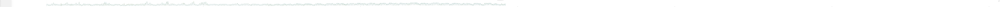

[92.26346  92.84111  77.743095 ... 82.29107  79.58972  56.13257 ]
Predictions(loc=array([4704.5527, 4604.5376, 4451.636 , ..., 5907.2812, 5614.737 ,
       5674.478 ], dtype=float32), scale=array([92.26346 , 92.84111 , 77.743095, ..., 82.29107 , 79.58972 ,
       56.13257 ], dtype=float32))


In [81]:
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


from xgboost import XGBRegressor 


def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
#     plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution()
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.loc, testpred.scale


plt.figure(figsize=(900, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+2*std, "r--",label="upper", alpha=0.5,linewidth = 1.0)
plt.plot(mean-2*std,"r--", label="lower", alpha=0.5,linewidth = 1.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

<BarContainer object of 23 artists>

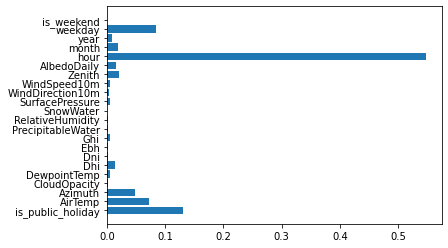

In [172]:
plt.barh(X_train.columns, xgb.feature_importances_)

In [98]:
data.index = data.date

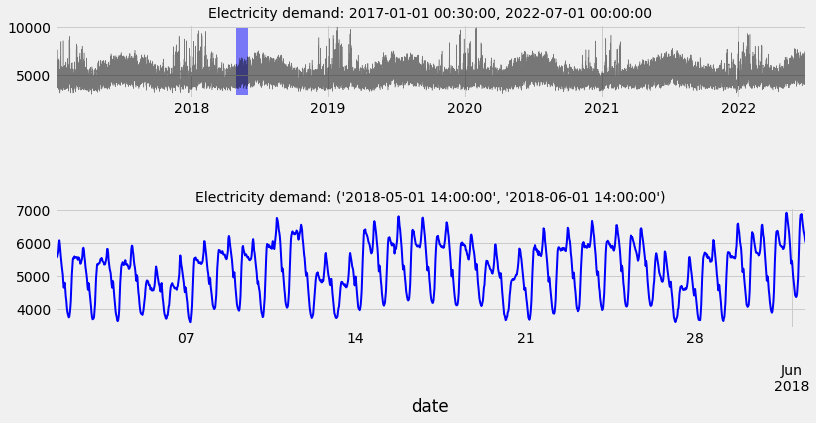

In [99]:

# data.added_PV_TOTALDEMAND = VIC_data.added_PV_TOTALDEMAND

# Zooming time series chart
# ==============================================================================
zoom = ('2018-05-01 14:00:00','2018-06-01 14:00:00')

fig = plt.figure(figsize=(12, 6))
grid = plt.GridSpec(nrows=8, ncols=1, hspace=0.6, wspace=0)

main_ax = fig.add_subplot(grid[1:3, :])
zoom_ax = fig.add_subplot(grid[5:, :])

data.added_PV_TOTALDEMAND.plot(ax=main_ax, c='black', alpha=0.5, linewidth=0.5)
min_y = min(data.added_PV_TOTALDEMAND)
max_y = max(data.added_PV_TOTALDEMAND)
main_ax.fill_between(zoom, min_y, max_y, facecolor='blue', alpha=0.5, zorder=0)
main_ax.set_xlabel('')

data.loc[zoom[0]: zoom[1]].added_PV_TOTALDEMAND.plot(ax=zoom_ax, color='blue', linewidth=2)

main_ax.set_title(f'Electricity demand: {data.index.min()}, {data.index.max()}', fontsize=14)
zoom_ax.set_title(f'Electricity demand: {zoom}', fontsize=14)
plt.subplots_adjust(hspace=1)

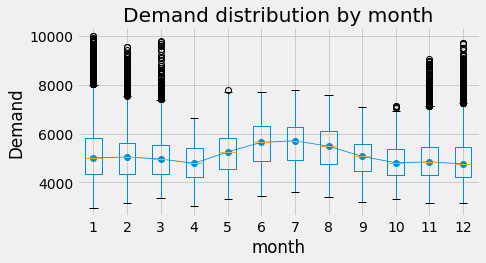

In [100]:
# Boxplot for annual seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['month'] = data.index.month
data.boxplot(column='added_PV_TOTALDEMAND', by='month', ax=ax,)
data.groupby('month')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by month')
fig.suptitle('');

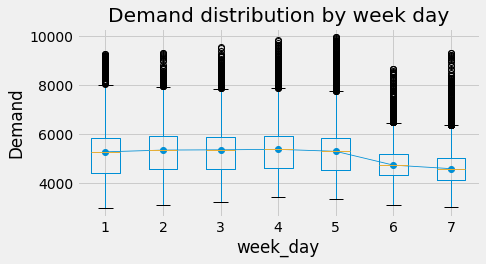

In [101]:
# Boxplot for weekly seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['week_day'] = data.index.day_of_week + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='week_day', ax=ax)
data.groupby('week_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by week day')
fig.suptitle('');

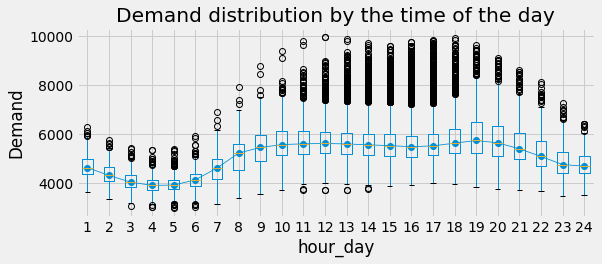

In [102]:
# Boxplot for daily seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 3.5))
data['hour_day'] = data.index.hour + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='hour_day', ax=ax)
data.groupby('hour_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by the time of the day')
fig.suptitle('');

In [103]:
df_SA=SA_data
SA_data['date'] = pd.to_datetime(df_SA['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_SA['is_public_holiday'] = 0
for j in range(len(df_SA)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_SA'][i] == True or Public_Holidays_data['AFMA_SA'][i] == True or Public_Holidays_data['ASX_SA'][i] == True:
            if Public_Holidays_data['Timedate'][i] == SA_data['date'][j].date():
                print(SA_data['date'][j].date())
                df_SA['is_public_holiday'][j] = 1
                                  


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26

2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01

2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10

2021-06-14
2021-06-14
2021-06-14
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27

In [104]:
data = pd.DataFrame(SA_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_SA.date.dt.hour
data["month"] = df_SA.date.dt.month
data["year"] = df_SA.date.dt.year
data["weekday"] = df_SA.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_SA.is_public_holiday
data



# data = pd.DataFrame(VIC_data.added_PV_TOTALDEMAND.copy())
# data.columns = ["y"]
# data["hour"] = df_VIC.date.dt.hour
# data["month"] = df_VIC.date.dt.month
# data["year"] = df_VIC.date.dt.year
# data["weekday"] = df_VIC.date.dt.weekday
# data['is_weekend'] = data.weekday.isin([5,6])*1
# data["is_public_holiday"] = df_VIC.is_public_holiday
# data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,1395.21000,0,1,2017,6,1,0
1,1306.86000,1,1,2017,6,1,0
2,1239.58000,1,1,2017,6,1,0
3,1173.09000,2,1,2017,6,1,0
4,1101.33000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,1915.56500,22,6,2022,3,0,0
96332,1818.77000,22,6,2022,3,0,0
96333,1710.43167,23,6,2022,3,0,0
96334,1640.45667,23,6,2022,3,0,0


In [106]:
df_SA.

,index,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND,date,is_public_holiday
0,2,2017-01-01 00:30:00.000,SA1,1395.21000,1395.21000,2017-01-01 00:30:00,0
1,7,2017-01-01 01:00:00.000,SA1,1306.86000,1306.86000,2017-01-01 01:00:00,0
2,12,2017-01-01 01:30:00.000,SA1,1239.58000,1239.58000,2017-01-01 01:30:00,0
3,17,2017-01-01 02:00:00.000,SA1,1173.09000,1173.09000,2017-01-01 02:00:00,0
4,22,2017-01-01 02:30:00.000,SA1,1101.33000,1101.33000,2017-01-01 02:30:00,0
...,...,...,...,...,...,...,...
96331,481657,2022-06-30 22:00:00.000,SA1,1915.56500,1915.56500,2022-06-30 22:00:00,0
96332,481662,2022-06-30 22:30:00.000,SA1,1818.77000,1818.77000,2022-06-30 22:30:00,0
96333,481667,2022-06-30 23:00:00.000,SA1,1710.43167,1710.43167,2022-06-30 23:00:00,0
96334,481672,2022-06-30 23:30:00.000,SA1,1640.45667,1640.45667,2022-06-30 23:30:00,0


In [105]:
xlsx_file = "-34.928499_138.600746_Solcast_PT30M.csv"   #SA
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

KeyError: "['level_0' 'index' 'SETTLEMENTDATE' 'REGIONID' 'TOTALDEMAND'\n 'added_PV_TOTALDEMAND' 'date' 'PeriodEnd' 'PeriodStart' 'Period'] not found in axis"

In [109]:
data = SA_data
data.index = data.date

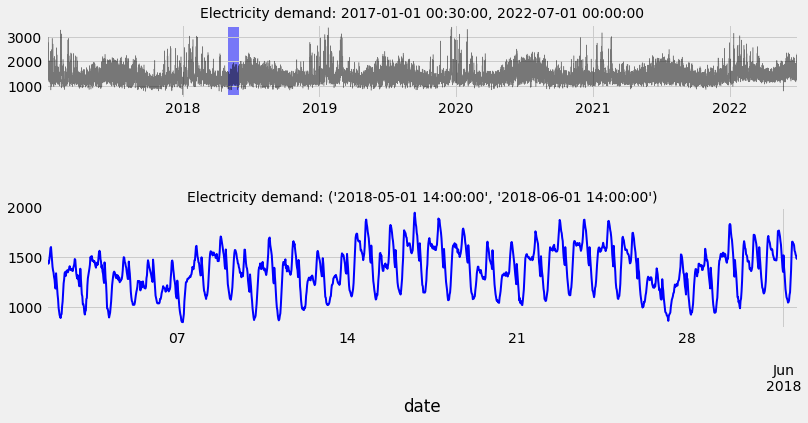

In [110]:
# data.added_PV_TOTALDEMAND = VIC_data.added_PV_TOTALDEMAND

# Zooming time series chart
# ==============================================================================
zoom = ('2018-05-01 14:00:00','2018-06-01 14:00:00')

fig = plt.figure(figsize=(12, 6))
grid = plt.GridSpec(nrows=8, ncols=1, hspace=0.6, wspace=0)

main_ax = fig.add_subplot(grid[1:3, :])
zoom_ax = fig.add_subplot(grid[5:, :])

data.added_PV_TOTALDEMAND.plot(ax=main_ax, c='black', alpha=0.5, linewidth=0.5)
min_y = min(data.added_PV_TOTALDEMAND)
max_y = max(data.added_PV_TOTALDEMAND)
main_ax.fill_between(zoom, min_y, max_y, facecolor='blue', alpha=0.5, zorder=0)
main_ax.set_xlabel('')

data.loc[zoom[0]: zoom[1]].added_PV_TOTALDEMAND.plot(ax=zoom_ax, color='blue', linewidth=2)

main_ax.set_title(f'Electricity demand: {data.index.min()}, {data.index.max()}', fontsize=14)
zoom_ax.set_title(f'Electricity demand: {zoom}', fontsize=14)
plt.subplots_adjust(hspace=1)

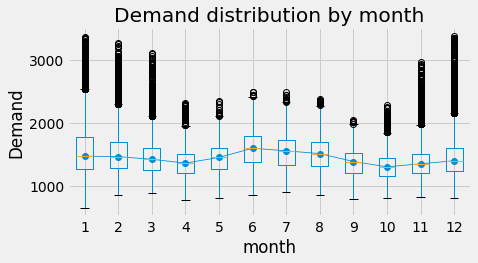

In [111]:
# Boxplot for annual seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['month'] = data.index.month
data.boxplot(column='added_PV_TOTALDEMAND', by='month', ax=ax,)
data.groupby('month')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by month')
fig.suptitle('');

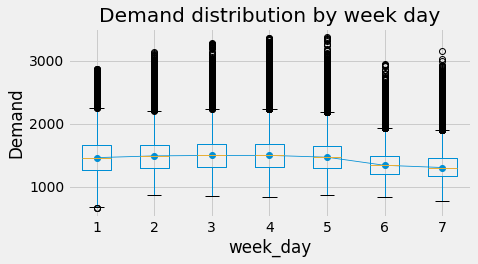

In [112]:
# Boxplot for weekly seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(7, 3.5))
data['week_day'] = data.index.day_of_week + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='week_day', ax=ax)
data.groupby('week_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by week day')
fig.suptitle('');

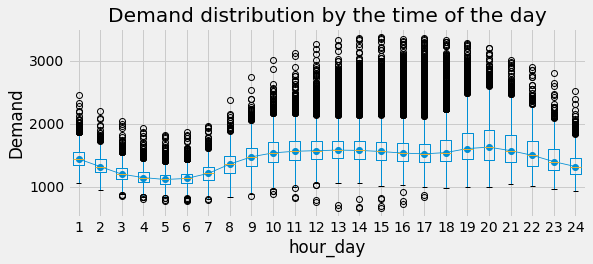

In [113]:
# Boxplot for daily seasonality
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 3.5))
data['hour_day'] = data.index.hour + 1
data.boxplot(column='added_PV_TOTALDEMAND', by='hour_day', ax=ax)
data.groupby('hour_day')['added_PV_TOTALDEMAND'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demand')
ax.set_title('Demand distribution by the time of the day')
fig.suptitle('');

6.5592391725207495
RMSE: 127.020368


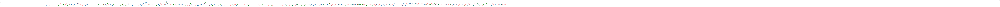

[49.228664 46.51582  46.217697 ... 54.555614 42.737324 39.43201 ]
Predictions(loc=array([1412.2278, 1253.2256, 1253.3022, ..., 1835.7765, 1682.8953,
       1552.4043], dtype=float32), scale=array([49.228664, 46.51582 , 46.217697, ..., 54.555614, 42.737324,
       39.43201 ], dtype=float32))


In [178]:
data = train_data


scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


from xgboost import XGBRegressor 


def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution()
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.loc, testpred.scale


plt.figure(figsize=(900, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+2*std, "r--",label="upper", alpha=0.5)
plt.plot(mean-2*std,"r--", label="lower", alpha=0.5)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

<BarContainer object of 23 artists>

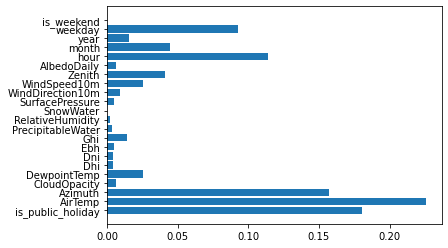

In [179]:
plt.barh(X_train.columns, xgb.feature_importances_)

In [185]:
df_TAS=TAS_data
df_TAS

NameError: name 'df_TAS' is not defined

In [187]:
df_TAS=TAS_data
TAS_data['date'] = pd.to_datetime(df_TAS['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_TAS['is_public_holiday'] = 0
for j in range(len(df_TAS)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_TAS'][i] == True or Public_Holidays_data['AFMA_TAS'][i] == True:
            if Public_Holidays_data['Timedate'][i] == TAS_data['date'][j].date(): 
                print(TAS_data['date'][j].date())
                df_TAS['is_public_holiday'][j] = 1 

2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


<ipython-input-187-096acf0dbcdb>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_TAS['is_public_holiday'][j] = 1


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13

2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25

2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01

2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27

In [188]:
data = pd.DataFrame(TAS_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_TAS.date.dt.hour
data["month"] = df_TAS.date.dt.month
data["year"] = df_TAS.date.dt.year
data["weekday"] = df_TAS.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_TAS.is_public_holiday
data



,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,863.08000,0,1,2017,6,1,0
1,872.00000,1,1,2017,6,1,0
2,852.53000,1,1,2017,6,1,0
3,832.05000,2,1,2017,6,1,0
4,815.47000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,1332.19000,22,6,2022,3,0,0
96332,1264.64667,22,6,2022,3,0,0
96333,1212.10833,23,6,2022,3,0,0
96334,1168.08167,23,6,2022,3,0,0


In [54]:
len(mean)

28901

In [191]:


xlsx_file = "-42.882605_147.32572_Solcast_PT30M.csv"   #TAS
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,13.8,-172.0,0.0,11.9,0.0,0.0,0.0,0.0,20.5,...,1.5,114.0,0.10,863.08000,0,1,2017,6,1,0
1,0.0,13.7,-165.0,0.0,11.9,0.0,0.0,0.0,0.0,20.6,...,1.5,112.0,0.11,872.00000,1,1,2017,6,1,0
2,0.0,13.6,-157.0,0.0,11.9,0.0,0.0,0.0,0.0,20.7,...,1.5,111.0,0.11,852.53000,1,1,2017,6,1,0
3,0.0,13.5,-151.0,0.0,12.0,0.0,0.0,0.0,0.0,20.8,...,1.5,108.0,0.11,832.05000,2,1,2017,6,1,0
4,0.0,13.4,-144.0,0.0,12.0,0.0,0.0,0.0,0.0,20.9,...,1.5,105.0,0.11,815.47000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,3.9,119.0,17.7,0.6,0.0,0.0,0.0,0.0,8.7,...,1.8,149.0,0.13,1332.19000,22,6,2022,3,0,0
96332,0.0,3.7,130.0,14.5,0.5,0.0,0.0,0.0,0.0,8.8,...,1.9,153.0,0.13,1264.64667,22,6,2022,3,0,0
96333,0.0,3.5,144.0,7.0,0.5,0.0,0.0,0.0,0.0,8.8,...,2.0,157.0,0.13,1212.10833,23,6,2022,3,0,0
96334,0.0,3.4,161.0,1.6,0.4,0.0,0.0,0.0,0.0,8.9,...,2.0,159.0,0.13,1168.08167,23,6,2022,3,0,0


6.720383765253531
RMSE: 89.549199


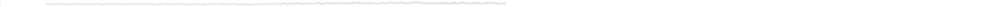

[41.949116 34.911785 27.990538 ... 22.035698 21.951473 19.535196]
Predictions(loc=array([1126.2733, 1059.3317, 1032.2435, ..., 1288.0042, 1264.9236,
       1227.3873], dtype=float32), scale=array([41.949116, 34.911785, 27.990538, ..., 22.035698, 21.951473,
       19.535196], dtype=float32))


In [196]:
data = train_data


scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


from xgboost import XGBRegressor 


def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution()
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.loc, testpred.scale


plt.figure(figsize=(900, 7))
# plt.scatter(testpred,)
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+2*std, "r--",label="upper", alpha=0.5)
plt.plot(mean-2*std,"r--", label="lower", alpha=0.5)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

<BarContainer object of 23 artists>

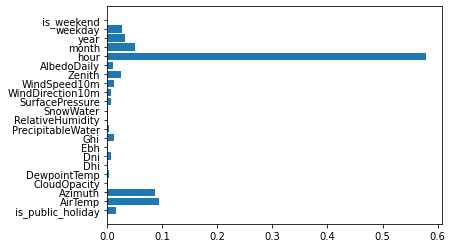

In [193]:
plt.barh(X_train.columns, xgb.feature_importances_)

In [117]:
df_QLD=QLD_data
QLD_data['date'] = pd.to_datetime(df_QLD['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_QLD['is_public_holiday'] = 0
for j in range(len(df_QLD)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_QLD'][i] == True or Public_Holidays_data['AFMA_QLD'][i] == True:
            if Public_Holidays_data['Timedate'][i] == QLD_data['date'][j].date(): 
                print(QLD_data['date'][j].date())
                df_QLD['is_public_holiday'][j] = 1

2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26

2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-08-15
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26

2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04

2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03

In [118]:
data = pd.DataFrame(QLD_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_QLD.date.dt.hour
data["month"] = df_QLD.date.dt.month
data["year"] = df_QLD.date.dt.year
data["weekday"] = df_QLD.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_QLD.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,6462.14000,0,1,2017,6,1,0
1,6352.82000,1,1,2017,6,1,0
2,6261.02000,1,1,2017,6,1,0
3,6169.66000,2,1,2017,6,1,0
4,6149.87000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,6409.50333,22,6,2022,3,0,0
96332,6192.50667,22,6,2022,3,0,0
96333,6021.77000,23,6,2022,3,0,0
96334,5892.94167,23,6,2022,3,0,0


In [121]:
xlsx_file = "-27.470453_153.026034_Solcast_PT30M.csv"   #TAS
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['Time','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,month,week_day,hour_day,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,1.0,7.0,2.0,24.5,-164.0,0.0,20.2,0.0,0.0,...,3.0,128.0,0.11,6462.14000,0,1,2017,6,1,0
1,0.0,1.0,7.0,2.0,24.2,-156.0,0.0,20.1,0.0,0.0,...,3.0,125.0,0.11,6352.82000,1,1,2017,6,1,0
2,0.0,1.0,7.0,3.0,24.1,-149.0,0.0,20.1,0.0,0.0,...,2.9,122.0,0.11,6261.02000,1,1,2017,6,1,0
3,0.0,1.0,7.0,3.0,23.9,-142.0,0.0,20.2,0.0,0.0,...,2.7,119.0,0.11,6169.66000,2,1,2017,6,1,0
4,0.0,1.0,7.0,4.0,23.8,-136.0,0.0,20.2,0.0,0.0,...,2.6,114.0,0.11,6149.87000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,6.0,4.0,23.0,16.7,96.0,68.5,15.7,0.0,0.0,...,1.4,158.0,0.11,6409.50333,22,6,2022,3,0,0
96332,0.0,6.0,4.0,24.0,16.6,102.0,67.5,15.7,0.0,0.0,...,1.4,165.0,0.11,6192.50667,22,6,2022,3,0,0
96333,0.0,6.0,4.0,24.0,16.5,117.0,74.6,15.6,0.0,0.0,...,1.4,171.0,0.11,6021.77000,23,6,2022,3,0,0
96334,0.0,7.0,5.0,1.0,16.4,165.0,70.1,15.5,0.0,0.0,...,1.5,175.0,0.12,5892.94167,23,6,2022,3,0,0


4.149916507609442
RMSE: 347.988046


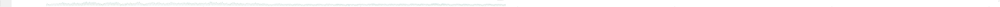

[104.63278  226.44478  188.82874  ...  67.46735   63.267834  71.43786 ]
Predictions(loc=array([7012.2104, 6948.302 , 6705.035 , ..., 6363.2744, 6251.6743,
       5933.0054], dtype=float32), scale=array([104.63278 , 226.44478 , 188.82874 , ...,  67.46735 ,  63.267834,
        71.43786 ], dtype=float32))


In [123]:
data = train_data


scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


from xgboost import XGBRegressor 


def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(800, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()
#     plt.title("Mean absolute percentage error {0:.2f}%".format(error))
#     rmse = np.sqrt(mean_squared_error(prediction, y_test))
#     print("RMSE: %f" % (rmse))
#     plt.legend(loc="best")
#     plt.tight_layout()
#     plt.grid(True);
xgb = XGBDistribution()
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.loc, testpred.scale


plt.figure(figsize=(900, 7))
# plt.scatter(testpred,)
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+2*std, "r--",label="upper", alpha=0.5, linewidth=1.0)
plt.plot(mean-2*std,"r--", label="lower", alpha=0.5, linewidth=1.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

In [134]:
new_prd = xgb.predict(X_test_scaled_1)

[7012.2104]
[104.63278]


<AxesSubplot:ylabel='Density'>

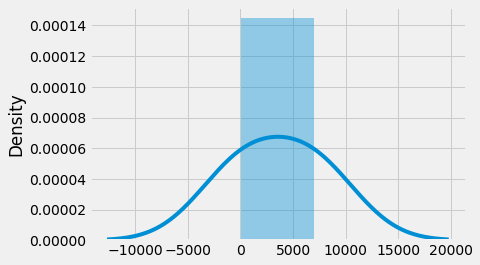

In [156]:
import seaborn as sb
print(new_prd.loc)
print(new_prd.scale)
sb.distplot(new_prd)

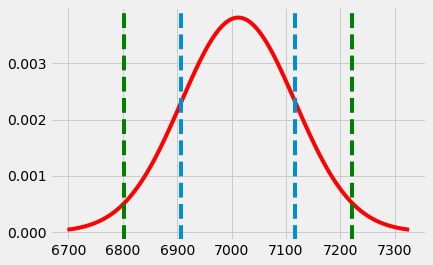

In [227]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
import math

mu = new_prd.loc[0],,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
# variance = 01
sigma = new_prd.scale[0]
x = np.linspace(mu - 1*sigma, mu + 1*sigma, 100)
# y = np.linspace(mu - 2*sigma, mu + 2*sigma, 100)
z = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
plt.plot(z, stats.norm.pdf(z, mu, sigma),color = 'red')
# plt.plot(z, stats.norm.pdf(z, mu, 2*sigma),color = 'blue')
# plt.plot(z, stats.norm.pdf(z, mu, 3*sigma),color = 'yellow')

plt.axvline(x=mu-sigma,linestyle = "--")
plt.axvline(x=mu+sigma,linestyle = "--")

plt.axvline(x=mu-2*sigma,linestyle = "--",color = 'green')
plt.axvline(x=mu+2*sigma,linestyle = "--",color = 'green')
new_y = stats.norm.pdf(z,loc = mu,scale = sigma)
# plt.fill_between(x,new_y,color = 'red')
plt.show()

In [216]:
z = np.linspace(0,10, 100)
z

array([ 0.        ,  0.1010101 ,  0.2020202 ,  0.3030303 ,  0.4040404 ,
        0.50505051,  0.60606061,  0.70707071,  0.80808081,  0.90909091,
        1.01010101,  1.11111111,  1.21212121,  1.31313131,  1.41414141,
        1.51515152,  1.61616162,  1.71717172,  1.81818182,  1.91919192,
        2.02020202,  2.12121212,  2.22222222,  2.32323232,  2.42424242,
        2.52525253,  2.62626263,  2.72727273,  2.82828283,  2.92929293,
        3.03030303,  3.13131313,  3.23232323,  3.33333333,  3.43434343,
        3.53535354,  3.63636364,  3.73737374,  3.83838384,  3.93939394,
        4.04040404,  4.14141414,  4.24242424,  4.34343434,  4.44444444,
        4.54545455,  4.64646465,  4.74747475,  4.84848485,  4.94949495,
        5.05050505,  5.15151515,  5.25252525,  5.35353535,  5.45454545,
        5.55555556,  5.65656566,  5.75757576,  5.85858586,  5.95959596,
        6.06060606,  6.16161616,  6.26262626,  6.36363636,  6.46464646,
        6.56565657,  6.66666667,  6.76767677,  6.86868687,  6.96

In [220]:
new_prd.loc[0]

7012.2104

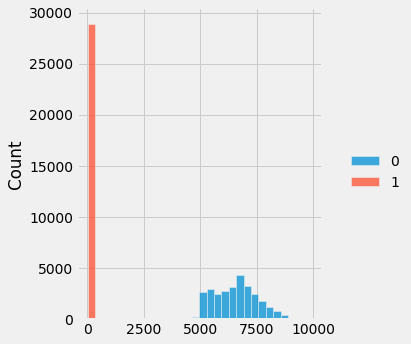

In [189]:
sb.displot(testpred)

In [144]:
X_test.head(2)
X_test_scaled_3 = scaler.transform((X_test.iloc[3]).reshape(-1,1))
X_test_scaled_3

AttributeError: 'Series' object has no attribute 'reshape'

In [125]:

def create_distribution_heatmap(
    model, x_range=(-2, 0), x_steps=100, y_range=(0, 100), normalize=True
):
    xx = np.linspace(x_range[0], x_range[1], x_steps)
    yy = np.linspace(y_range[0], y_range[1], y_range[1] - y_range[0] + 1)
    ym, xm = np.meshgrid(xx, yy)

    z = predict_distribution(model, xx, yy)

    if normalize:
        z = z / z.max(axis=0)

    return ym, xm, z.transpose()
xm, ym, z = create_distribution_heatmap(xgb)

XGBoostError: [13:35:09] C:/Users/administrator/workspace/xgboost-win64_release_1.6.0/src/predictor/cpu_predictor.cc:310: Check failed: m->NumColumns() == model.learner_model_param->num_feature (1 vs. 26) : Number of columns in data must equal to trained model.

<BarContainer object of 26 artists>

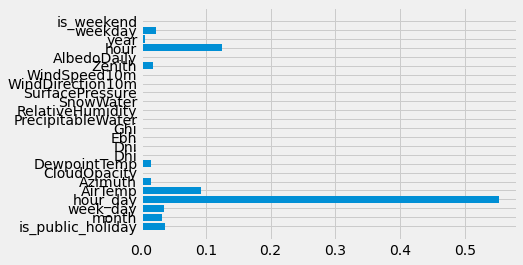

In [124]:
plt.barh(X_train.columns, xgb.feature_importances_)